<a href="https://colab.research.google.com/github/alisonmitchell/Biomedical-Knowledge-Graph/blob/main/02_Exploratory_Data_Analysis/Word_Embeddings.ipynb"
   target="_parent">
   <img src="https://colab.research.google.com/assets/colab-badge.svg"
      alt="Open in Colab">
</a>

# Representation Learning - Word Embeddings

## 1. Introduction

Categorical and weighted word representation models, such as CountVectorizer and TF-IDF, are statistical algorithms and completely dependent on the frequency of occurrence. They fail to capture the semantic and syntactic meaning of words, and also suffer from the curse of dimensionality. These traditional methods were outperformed by continuous word representation, or non-contextual, static word embedding models such as prediction-based Word2Vec and count-based GloVe.

Word embeddings are distributed dense vector representations of words that capture their semantic and syntactic meaning, with similar words being mapped to similar feature vectors. These vectors can then be used to train machine learning models.

## 2. Install/import libraries

In [ ]:
!pip install chart-studio yellowbrick gensim umap-learn embedding-explorer

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.express as px
import plotly.offline as pyo
import plotly.graph_objects as go
import chart_studio.plotly as py
import pickle
import gensim
import warnings
warnings.filterwarnings("ignore")

from time import time

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans

from umap import UMAP
from yellowbrick.cluster import SilhouetteVisualizer
from yellowbrick.text import TSNEVisualizer
from chart_studio.plotly import plot, iplot

from gensim.models import Word2Vec

from embedding_explorer import show_network_explorer

## 3. Word2Vec

The term "word embeddings" was originally coined by [Bengio et al. in 2003](https://www.jmlr.org/papers/volume3/bengio03a/bengio03a.pdf) but popularised in 2013 by the famous Word2Vec algorithm, a predictive, shallow neural network model for generating static word embeddings which represent words as dense vectors in a continuous vector space.

Mikolov et al's [Word2Vec paper](https://arxiv.org/pdf/1301.3781) proposed two new model architectures for learning distributed representations of words - the Continuous Bag of Words (CBOW) model which predicts a target word given its context words, and the Skip-gram model which predicts context words given a target word.

In [ ]:
with open('2024-03-02_pmc_arxiv_full_text_merged_plus_cleaned_article_titles_test_tokenized.pickle', 'rb') as f:
    pmc_arxiv_full_text_merged_plus_cleaned_article_titles_test = pickle.load(f)

In [ ]:
pmc_arxiv_full_text_merged_plus_cleaned_article_titles_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20 entries, 0 to 19
Data columns (total 15 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   article_id     20 non-null     object
 1   published      20 non-null     object
 2   revised        20 non-null     object
 3   title          20 non-null     object
 4   title_cleaned  20 non-null     object
 5   journal        20 non-null     object
 6   authors        20 non-null     object
 7   doi            20 non-null     object
 8   pdf_url        20 non-null     object
 9   text           20 non-null     object
 10  text_cleaned   20 non-null     object
 11  word_tok       20 non-null     object
 12  sent_tok       20 non-null     object
 13  word_count     20 non-null     int64 
 14  sent_count     20 non-null     int64 
dtypes: int64(2), object(13)
memory usage: 2.5+ KB


The [Gensim library's implementation](https://radimrehurek.com/gensim/models/word2vec.html) of Word2Vec expects the corpus, or `sentences` iterable, to be a re-iterable sequence where each item is itself a list of string tokens.

We will perform the necessary preprocessing by converting a sentence-tokenised column of article text into a list of word-tokenised sentences.



In [ ]:
# Convert the sentence-tokenised articles into word-tokenised sentences
word2vec_input = pmc_arxiv_full_text_merged_plus_cleaned_article_titles_test['sent_tok'].apply(lambda article: [sentence.split() for sentence in article])

# Flatten the list of lists into a single list of all word-tokenised sentences
sentences = [sentence for article in word2vec_input for sentence in article]

In [ ]:
len(sentences)

4121

In [ ]:
sentences[:5]

[['sir',
  'james',
  'black',
  'winner',
  'nobel',
  'prize',
  'clearly',
  'recognized',
  '21st',
  'century',
  'drug',
  'repurposing',
  'strategies',
  'occupy',
  'important',
  'place',
  'future',
  'new',
  'drug',
  'discovery.'],
 ['ted',
  't.',
  'ashburn',
  'summarized',
  'previous',
  'research',
  'developed',
  'general',
  'approach',
  'drug',
  'development',
  'drug',
  'repurposing',
  'retrospectively',
  'looking',
  'new',
  'indications',
  'approved',
  'drugs',
  'molecules',
  'waiting',
  'approval',
  'new',
  'pathways',
  'action',
  'targets.'],
 ['molecules',
  'usually',
  'safe',
  'clinical',
  'trials',
  'sufficient',
  'efficacy',
  'treatment',
  'disease',
  'originally',
  'targeted.'],
 ['definition', 'term', 'drug', 'repurposing', 'endorsed', 'scholars.'],
 ['pointed',
  'synonyms',
  'drug',
  'repurposing',
  'academics',
  'include',
  'drug',
  'repositioning',
  'drug',
  'rediscovery',
  'drug',
  'redirecting',
  'drug',
  're

Sentences appear to have full stops as part of the last token, so we will remove these.

In [ ]:
def remove_end_punctuation(word_tokenized_sentences):
    processed_sentences = []
    for sentence in word_tokenized_sentences:
        # Check if the last word ends with a full stop
        if sentence[-1].endswith('.'):
            sentence[-1] = sentence[-1][:-1]  # Remove the full stop from the last word
        processed_sentences.append(sentence)
    return processed_sentences

In [ ]:
corpus = remove_end_punctuation(sentences)

In [ ]:
len(corpus)

4121

In [ ]:
corpus[:5]

[['sir',
  'james',
  'black',
  'winner',
  'nobel',
  'prize',
  'clearly',
  'recognized',
  '21st',
  'century',
  'drug',
  'repurposing',
  'strategies',
  'occupy',
  'important',
  'place',
  'future',
  'new',
  'drug',
  'discovery'],
 ['ted',
  't.',
  'ashburn',
  'summarized',
  'previous',
  'research',
  'developed',
  'general',
  'approach',
  'drug',
  'development',
  'drug',
  'repurposing',
  'retrospectively',
  'looking',
  'new',
  'indications',
  'approved',
  'drugs',
  'molecules',
  'waiting',
  'approval',
  'new',
  'pathways',
  'action',
  'targets'],
 ['molecules',
  'usually',
  'safe',
  'clinical',
  'trials',
  'sufficient',
  'efficacy',
  'treatment',
  'disease',
  'originally',
  'targeted'],
 ['definition', 'term', 'drug', 'repurposing', 'endorsed', 'scholars'],
 ['pointed',
  'synonyms',
  'drug',
  'repurposing',
  'academics',
  'include',
  'drug',
  'repositioning',
  'drug',
  'rediscovery',
  'drug',
  'redirecting',
  'drug',
  'retask

In [ ]:
with open('2024-09-17_word_tok_sents.pickle', 'wb') as f:
    pickle.dump(corpus, f)

## 4. CBOW model

By default Word2Vec uses the CBOW model so the boolean `sg` skip-gram parameter is optional according to the documentation - sg ({0, 1}, optional) - Training algorithm: 1 for skip-gram; otherwise CBOW.

The model is then trained using (context, target) pairs to minimise the difference between predicted and actual target word.

With respect to other parameters, `vector_size` has been left as the default of 100. `window`, or maximum distance between the current and predicted word within a sentence, has been set to 10 which considers wider context, capturing more semantic relationships between words. A lower value here would focus on local context and capture syntactic information. `min_count` ignores all words with total frequency lower than this. The default is 5 but has been set to 1 to include everything in the vocabulary, but may also include noise.

In [ ]:
# Build vocabulary and train Word2Vec model
word2vec_model = Word2Vec(sentences=corpus, vector_size=100, window=10, min_count=1, workers=2)

In [ ]:
# Summarise the loaded model
print(word2vec_model)

Word2Vec<vocab=9360, vector_size=100, alpha=0.025>


In [ ]:
# Summarise vocabulary
words = list(word2vec_model.wv.index_to_key)
print(words)

['drug', 'drugs', 'covid-19', 'sars-cov-2', 'repurposing', 'protein', 'data', 'studies', 'network', 'study', 'genes', 'disease', 'based', 'binding', 'target', 'proteins', 'potential', 'molecular', 'viral', 'research', 'analysis', 'targets', 'new', 'treatment', 'clinical', 'docking', 'compounds', 'virus', 'interactions', 'interaction', 'methods', 'approaches', 'gene', 'diseases', 'model', 'antiviral', 'human', 'repositioning', 'development', 'biological', 'information', 'results', 'host', 'discovery', 'different', 'in', 'identified', 's', 'use', 'repurposed', 'molecules', 'screening', 'learning', 'structure', 'networks', 'computational', 'approved', 'ligand', 'fda', 'active', 'patients', 'approach', 'shown', 'rdrp', 'complex', 'number', 'replication', 'known', 'activity', 'rna', 'time', 'method', 'trials', 'remdesivir', 'effects', 'expression', 'protease', 'set', 'high', 'cov', 'coronavirus', 'effective', 'models', 'cell', 'energy', 'novel', 'main', 'process', 'showed', 'including', 'fo

In [ ]:
with open('2024-09-22_wv_ind_to_key.pickle', 'wb') as f:
  pickle.dump(words, f)

In [ ]:
# Access word embeddings
word = 'covid-19'
word2vec_embedding = word2vec_model.wv[word]

In [ ]:
# 100-dimensional raw embedding vector the model has learned during training
word2vec_embedding

array([-1.0767739 ,  0.7484529 ,  0.7208827 ,  0.4818461 ,  0.01469123,
       -1.4560386 ,  0.9506996 ,  2.1042309 , -1.0283414 , -1.0692954 ,
       -0.37080216, -1.6728958 , -0.04596005,  0.46943158,  0.3925194 ,
       -0.20221224, -0.12447512, -1.6699429 , -0.6018132 , -1.8671025 ,
        0.28981972,  0.9285944 ,  0.5434485 , -0.890986  ,  0.28730288,
        0.6481741 , -1.3456401 , -0.70127153, -0.95483685,  0.56971854,
        0.69290733,  0.17547187,  0.3719229 , -0.20560662, -1.030092  ,
        0.8913152 , -0.35861546, -1.0350718 , -0.43664238, -2.296887  ,
        0.4554859 , -0.8584908 , -1.0440638 ,  0.08375745,  0.38499168,
       -0.53748596, -0.74649405,  0.03921065, -0.11316916,  0.8516696 ,
        0.90192765, -1.0801713 , -0.00613644, -0.40402153, -0.6739413 ,
        1.033101  ,  0.48271784, -0.12383418, -0.86827105,  0.29455957,
        1.2752496 ,  0.4682249 , -0.83515906,  0.17994858, -1.0594752 ,
        1.1236721 ,  0.3967631 ,  0.32090813, -1.1554514 ,  0.93

According to the [documentation](https://radimrehurek.com/gensim/models/word2vec.html), if you need a single unit-normalised vector for some key, call `get_vector()` instead: `word2vec_model.wv.get_vector(key, norm=True)`. If True, forget the original trained vectors and only keep the normalised ones. You lose information if you do this.

In [ ]:
word2vec_normed_vector = word2vec_model.wv.get_vector('covid-19', norm=True)
print(word2vec_normed_vector)

[-0.1229645   0.08547118  0.08232275  0.05502545  0.0016777  -0.16627546
  0.10856719  0.24029715 -0.11743365 -0.12211049 -0.04234455 -0.19103992
 -0.00524851  0.05360775  0.0448246  -0.02309206 -0.0142147  -0.1907027
 -0.06872535 -0.21321778  0.03309659  0.10604283  0.06206027 -0.10174806
  0.03280917  0.07401963 -0.15366825 -0.08008321 -0.10903964  0.06506023
  0.07912804  0.02003839  0.04247253 -0.02347969 -0.11763357  0.10178565
 -0.04095286 -0.11820225 -0.04986331 -0.26229793  0.05201519 -0.0980372
 -0.11922911  0.00956486  0.04396495 -0.06137936 -0.08524749  0.00447774
 -0.01292359  0.09725824  0.10299756 -0.12335248 -0.00070076 -0.0461381
 -0.07696217  0.11797718  0.055125   -0.01414151 -0.09915408  0.03363786
  0.14562987  0.05346995 -0.09537278  0.02054961 -0.12098904  0.12832014
  0.04530921  0.03664679 -0.13194925  0.10653384 -0.13537306  0.01223454
  0.1364199  -0.1376865   0.04415903  0.05427634  0.07633992  0.03272711
 -0.06504276  0.06976155 -0.06406024  0.03801214 -0.16

In [ ]:
# save model
word2vec_model.save('word2vec_model.bin')

In [ ]:
# load model
word2vec_model = Word2Vec.load('word2vec_model.bin')
print(word2vec_model)

Word2Vec<vocab=9360, vector_size=100, alpha=0.025>


The model vocabulary consists of 9360 x 100-dimensional vectors.

In [ ]:
print(word2vec_model.wv.vectors)

[[-1.1833237e+00  8.0426741e-01  8.2282776e-01 ... -8.8851035e-01
   5.0440156e-01  2.6977056e-01]
 [-1.0943283e+00  7.6239371e-01  7.4734497e-01 ... -8.1063199e-01
   4.5485443e-01  2.3230807e-01]
 [-1.0767739e+00  7.4845290e-01  7.2088271e-01 ... -7.9765320e-01
   4.7507843e-01  2.0733878e-01]
 ...
 [-6.4032199e-03  9.6615860e-03  9.6920170e-03 ... -1.7244246e-02
   1.3955979e-02  5.4944842e-03]
 [-2.2316583e-02  1.0532350e-03  5.4111015e-03 ... -8.0871824e-03
  -3.5223225e-03  9.3937935e-03]
 [-1.7060971e-02  9.0855910e-03  1.3590406e-02 ... -1.4473253e-03
   1.1237609e-02  1.0018846e-02]]


Return a `dict_keys` object with all the words (keys) in the vocabulary and their index.

In [ ]:
print(word2vec_model.wv.key_to_index)

{'drug': 0, 'drugs': 1, 'covid-19': 2, 'sars-cov-2': 3, 'repurposing': 4, 'protein': 5, 'data': 6, 'studies': 7, 'network': 8, 'study': 9, 'genes': 10, 'disease': 11, 'based': 12, 'binding': 13, 'target': 14, 'proteins': 15, 'potential': 16, 'molecular': 17, 'viral': 18, 'research': 19, 'analysis': 20, 'targets': 21, 'new': 22, 'treatment': 23, 'clinical': 24, 'docking': 25, 'compounds': 26, 'virus': 27, 'interactions': 28, 'interaction': 29, 'methods': 30, 'approaches': 31, 'gene': 32, 'diseases': 33, 'model': 34, 'antiviral': 35, 'human': 36, 'repositioning': 37, 'development': 38, 'biological': 39, 'information': 40, 'results': 41, 'host': 42, 'discovery': 43, 'different': 44, 'in': 45, 'identified': 46, 's': 47, 'use': 48, 'repurposed': 49, 'molecules': 50, 'screening': 51, 'learning': 52, 'structure': 53, 'networks': 54, 'computational': 55, 'approved': 56, 'ligand': 57, 'fda': 58, 'active': 59, 'patients': 60, 'approach': 61, 'shown': 62, 'rdrp': 63, 'complex': 64, 'number': 65, 

In [ ]:
wv_key_to_ind = word2vec_model.wv.key_to_index

In [ ]:
with open('2024-09-22_wv_key_to_ind.pickle', 'wb') as f:
  pickle.dump(wv_key_to_ind, f)

Fetch vectors for a word list.

In [ ]:
all_word2vec_vectors = []
for index, vector in enumerate(word2vec_model.wv.vectors):
    vector_object = {}
    vector_object[list(word2vec_model.wv.key_to_index)[index]] = vector
    all_word2vec_vectors.append(vector_object)

In [ ]:
all_word2vec_vectors[0:10]

[{'drug': array([-1.1833237 ,  0.8042674 ,  0.82282776,  0.5687558 , -0.03007466,
         -1.6294714 ,  1.0918688 ,  2.3609037 , -1.1370975 , -1.205116  ,
         -0.39869657, -1.879201  , -0.08285532,  0.54214317,  0.40226346,
         -0.22785182, -0.14382681, -1.8594971 , -0.6764063 , -2.0950074 ,
          0.3699634 ,  1.0360045 ,  0.6235946 , -0.9677569 ,  0.33151948,
          0.73392004, -1.5122278 , -0.76142246, -1.0672089 ,  0.6376846 ,
          0.73698086,  0.21272026,  0.476133  , -0.258427  , -1.1522212 ,
          0.98712885, -0.38087577, -1.1839831 , -0.49048707, -2.565681  ,
          0.49234083, -0.94796336, -1.1890603 ,  0.0987012 ,  0.4143749 ,
         -0.62003785, -0.836681  ,  0.0504134 , -0.10610109,  0.97983104,
          0.9850828 , -1.1944499 ,  0.00621801, -0.4344461 , -0.70224863,
          1.1535431 ,  0.52884483, -0.14771111, -0.9709436 ,  0.3426161 ,
          1.4141475 ,  0.50384563, -0.9381246 ,  0.19463228, -1.1767569 ,
          1.2536229 ,  0.40671

In [ ]:
# retrieve all of the vectors for single unit-normalised vectors
X = word2vec_model.wv.get_normed_vectors()

In [ ]:
len(X)

9360

In [ ]:
X

array([[-0.12128313,  0.08243228,  0.08433459, ..., -0.09106664,
         0.05169794,  0.02764976],
       [-0.12394793,  0.08635172,  0.08464723, ..., -0.09181537,
         0.0515186 ,  0.02631213],
       [-0.1229645 ,  0.08547118,  0.08232275, ..., -0.09108972,
         0.0542526 ,  0.0236775 ],
       ...,
       [-0.04444984,  0.06706876,  0.06728   , ..., -0.11970603,
         0.09687955,  0.03814159],
       [-0.19213974,  0.00906807,  0.04658812, ..., -0.06962845,
        -0.03032625,  0.08087803],
       [-0.18951851,  0.10092554,  0.1509664 , ..., -0.01607734,
         0.12483082,  0.11129242]], dtype=float32)

In [ ]:
with open('2024-09-22_word2vec_normed_vectors.pickle', 'wb') as f:
  pickle.dump(X, f)

In [ ]:
# And for raw vectors
X = word2vec_model.wv.vectors

In [ ]:
len(X)

9360

In [ ]:
X

array([[-1.1833237e+00,  8.0426741e-01,  8.2282776e-01, ...,
        -8.8851035e-01,  5.0440156e-01,  2.6977056e-01],
       [-1.0943283e+00,  7.6239371e-01,  7.4734497e-01, ...,
        -8.1063199e-01,  4.5485443e-01,  2.3230807e-01],
       [-1.0767739e+00,  7.4845290e-01,  7.2088271e-01, ...,
        -7.9765320e-01,  4.7507843e-01,  2.0733878e-01],
       ...,
       [-6.4032199e-03,  9.6615860e-03,  9.6920170e-03, ...,
        -1.7244246e-02,  1.3955979e-02,  5.4944842e-03],
       [-2.2316583e-02,  1.0532350e-03,  5.4111015e-03, ...,
        -8.0871824e-03, -3.5223225e-03,  9.3937935e-03],
       [-1.7060971e-02,  9.0855910e-03,  1.3590406e-02, ...,
        -1.4473253e-03,  1.1237609e-02,  1.0018846e-02]], dtype=float32)

In [ ]:
with open('2024-09-22_word2vec_raw_vectors.pickle', 'wb') as f:
  pickle.dump(X, f)

We can find the top-n most similar keys (default is 10) using the [`most_similar()`](https://radimrehurek.com/gensim/models/keyedvectors.html#gensim.models.keyedvectors.KeyedVectors.most_similar) method. Positive keys contribute positively towards the similarity, negative keys negatively. This method computes cosine similarity between a simple mean of the projection weight vectors of the given keys and the vectors for each key in the model.

We will try this for a few words in the corpus.

In [ ]:
word2vec_model.wv.most_similar(positive=['drug'])

[('development', 0.9998803734779358),
 ('discovery', 0.999866783618927),
 ('new', 0.9998570680618286),
 ('methods', 0.999840497970581),
 ('research', 0.9998142123222351),
 ('repurposing', 0.9997884035110474),
 ('strategy', 0.9997875690460205),
 ('studies', 0.9997844099998474),
 ('novel', 0.9997817873954773),
 ('based', 0.9997779130935669)]

In [ ]:
word2vec_model.wv.most_similar(positive=['disease'])

[('use', 0.999896764755249),
 ('covid-19', 0.9998933672904968),
 ('data', 0.9998932480812073),
 ('diseases', 0.9998908042907715),
 ('analysis', 0.9998893141746521),
 ('targets', 0.9998884797096252),
 ('study', 0.9998883605003357),
 ('time', 0.9998852610588074),
 ('information', 0.9998838305473328),
 ('biological', 0.9998809099197388)]

In [ ]:
word2vec_model.wv.most_similar(positive=['pandemic'])

[('treatment', 0.9997208714485168),
 ('drugs', 0.9997132420539856),
 ('effective', 0.9996936917304993),
 ('compounds', 0.9996917843818665),
 ('patients', 0.9996911287307739),
 ('fda', 0.9996902942657471),
 ('covid-19', 0.999688446521759),
 ('shown', 0.9996857047080994),
 ('study', 0.9996852278709412),
 ('health', 0.9996770024299622)]

In [ ]:
word2vec_model.wv.most_similar(positive=['spike'])

[('sars-cov-2', 0.9997439384460449),
 ('virus', 0.9997256398200989),
 ('protein', 0.9997167587280273),
 ('proteins', 0.9997069239616394),
 ('activity', 0.9996907711029053),
 ('human', 0.9996887445449829),
 ('cell', 0.9996877908706665),
 ('domain', 0.9996845722198486),
 ('rna', 0.9996841549873352),
 ('viral', 0.9996767044067383)]

We can also specify both positive and negative examples to indicate what should and should not be considered as related, for example if we only wanted to consider humans rather than animals in the given context.

In [ ]:
w1 = ["vaccine", "virus", "pandemic", "infection"]
w2 = ["animals"]
word2vec_model.wv.most_similar(positive=w1, negative=w2)

[('lopinavir', 0.9971597194671631),
 ('coronavirus', 0.9969862699508667),
 ('remdesivir', 0.9969311952590942),
 ('sequence', 0.9969280958175659),
 ('significantly', 0.9969078898429871),
 ('antiviral', 0.9969075918197632),
 ('predict', 0.9968978762626648),
 ('like', 0.9968894720077515),
 ('positive', 0.9968816041946411),
 ('effects', 0.9968738555908203)]

We can return similarity between two words whether they are identical, different but related, or different and unrelated.

In [ ]:
# similarity between two identical words
word2vec_model.wv.similarity(w1="pandemic",w2="pandemic")

1.0

In [ ]:
# similarity between two different words
word2vec_model.wv.similarity(w1="pandemic",w2="epidemic")

0.9931583

In [ ]:
# similarity between two unrelated words
word2vec_model.wv.similarity(w1="japan",w2="ted")

0.19986695

We can also identify the odd one out in a list.

In [ ]:
# Which one is the odd one out in this list?
word2vec_model.wv.doesnt_match(["animal","human", "disease", "japan"])

'japan'

### 4.1 2D PCA - CBOW embeddings

We will plot the word embeddings for the default CBOW model after dimensionality reduction to two principal components.

In [ ]:
# create a list of all the words in the corpus
words = list(word2vec_model.wv.key_to_index)

We will load the data for the raw vectors first.

In [ ]:
with open('2024-09-22_word2vec_raw_vectors.pickle', 'rb') as f:
  X = pickle.load(f)

In [ ]:
# fit a 2d PCA model to the vectors
pca = PCA(n_components=2)
pca2_result = pca.fit_transform(X)

In [ ]:
with open('2024-09-22_word2vec_pca2_raw_vectors.pickle', 'wb') as f:
  pickle.dump(pca2_result, f)

In [ ]:
# Add the 2D output to a DataFrame
labels = ['PC'+str(i) for i in range(1,3)]
pca2_word2vec_raw_df = pd.DataFrame(pca2_result[:,0:2], columns=labels)

In [ ]:
with open('2024-09-22_pca2_word2vec_raw_df.pickle', 'wb') as f:
  pickle.dump(pca2_word2vec_raw_df, f)

In [ ]:
pca2_word2vec_raw_df

,PC1,PC2
0,9.328009,0.211956
1,8.402455,0.054775
2,8.330387,0.078561
3,7.915372,-0.104685
4,6.468690,0.207075
...,...,...
9355,-0.341446,0.009857
9356,-0.347871,-0.010820
9357,-0.292833,-0.005536
9358,-0.326456,-0.005992


#### 4.1.1 2D PCA CBOW raw vectors scatterplot

In [ ]:
# Create a list of strings containing x, y, and word for each point
hover_text = [f'Word: {word}<br>x: {x}<br>y: {y}' for word, x, y in zip(words, pca2_result[:, 0], pca2_result[:, 1])]

# Create a scatter plot
fig = go.Figure()

# Add scatter trace
fig.add_trace(go.Scatter(
    x=pca2_result[:, 0],
    y=pca2_result[:, 1],
    mode='markers',
    marker=dict(
        size=8,
    ),
    text=hover_text,  # Assign hover text
    hoverinfo='text',  # Set hoverinfo to show text on hover
))

# Update layout
fig.update_layout(
    title='2D Word2Vec Model Scatter Plot - Raw vectors',
    xaxis=dict(
        title='Principal Component 1',
        tickfont=dict(size=10),
    ),
    yaxis=dict(
        title='Principal Component 2',
        tickfont=dict(size=10),
    ),
)

# Show the plot
fig.show()

And compare the plot with normalised vectors.

In [ ]:
with open('2024-09-22_word2vec_normed_vectors.pickle', 'rb') as f:
  X = pickle.load(f)

In [ ]:
# fit a 2d PCA model to the vectors
pca = PCA(n_components=2)
pca2n_result = pca.fit_transform(X)

#### 4.1.2 2D PCA CBOW normalised vectors scatterplot

In [ ]:
# Create a list of strings containing x, y, and word for each point
hover_text = [f'Word: {word}<br>x: {x}<br>y: {y}' for word, x, y in zip(words, pca2n_result[:, 0], pca2n_result[:, 1])]

# Create a scatter plot
fig = go.Figure()

# Add scatter trace
fig.add_trace(go.Scatter(
    x=pca2n_result[:, 0],
    y=pca2n_result[:, 1],
    mode='markers',
    marker=dict(
        size=8,
    ),
    text=hover_text,  # Assign hover text
    hoverinfo='text',  # Set hoverinfo to show text on hover
))

# Update layout
fig.update_layout(
    title='2D Word2Vec Model Scatter Plot - Normalised vectors',
    xaxis=dict(
        title='Principal Component 1',
        tickfont=dict(size=10),
    ),
    yaxis=dict(
        title='Principal Component 2',
        tickfont=dict(size=10),
    ),t
)

# Show the plot
fig.show()

We can see that the normalised vectors look very different when plotted.

According to the [documentation](https://radimrehurek.com/gensim/models/word2vec.html), if you need a single unit-normalised vector for some key, call `get_vector()` instead: `word2vec_model.wv.get_vector(key, norm=True)`. If True, forget the original trained vectors and only keep the normalised ones. You lose information if you do this.

If `norm=True`, the vector is normalised to have unit length (i.e., a vector of magnitude 1). You are dividing each component by its magnitude so that it becomes 1, and therefore changing its magnitude but not its direction.



#### 4.1.3 K-means CBOW raw vectors

In [ ]:
len(pca2_result)

9360

In [ ]:
def cluster(n_clusters):
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(pca2_result)
    Z = kmeans.predict(pca2_result)
    return kmeans, Z

In [ ]:
max_clusters = 15

In [ ]:
inertias = np.zeros(max_clusters)

for i in range(1, max_clusters):
    kmeans, Z = cluster(i)
    inertias[i] = kmeans.inertia_

#### 4.1.4 Elbow method - CBOW

In [ ]:
data_km = go.Scatter(
            x=list(range(1, max_clusters)),
            y=inertias[1:]
    )

layout_km = go.Layout(
    title='2D PCA Word2Vec raw vectors - Elbow method',
    xaxis=go.layout.XAxis(title='Number of clusters',
                   range=[0, max_clusters]),
    yaxis=go.layout.YAxis(title='Inertia')
)

fig0 = go.Figure(data=data_km, layout=layout_km)

In [ ]:
pyo.plot(fig0, filename='pca2_word2vec-raw-article-text-clustering-inertias')

'pca2_word2vec-raw-article-text-clustering-inertias.html'

In [ ]:
fig0.show(renderer="colab", filename='pca2_word2vec-raw-article-text-clustering-inertias')

We will try four clusters and see how the silhouette plot looks.

#### 4.1.5 Silhouette Plot - 4 clusters

In [ ]:
n_clusters = 4
model, Z = cluster(n_clusters)

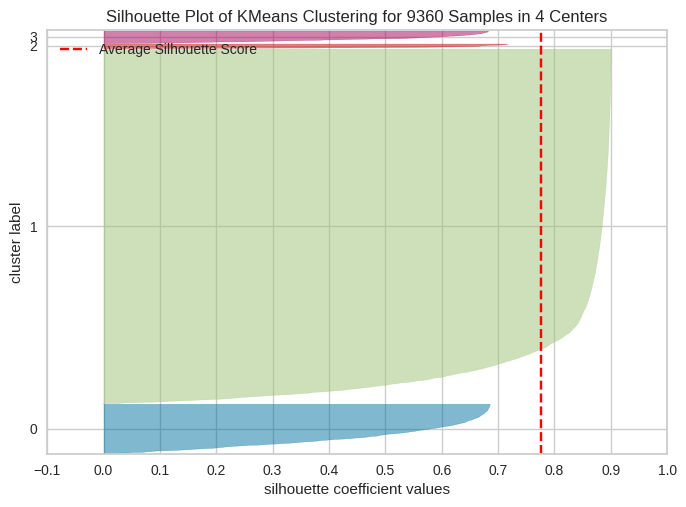

In [ ]:
# Instantiate the clustering model and visualiser
visualizer = SilhouetteVisualizer(model, colors='yellowbrick')

visualizer.fit(pca2_result)
visualizer.show();

There is very noticeable cluster imbalance here with one very large cluster and three much smaller ones that stop short of the average silhouette score. This indicates bad clustering with the below average score indicating that instances are too close to other clusters. We will try again with a higher number of clusters.

#### 4.1.6 Silhouette Plot - 10 clusters

In [ ]:
n_clusters = 10
model, Z = cluster(n_clusters)

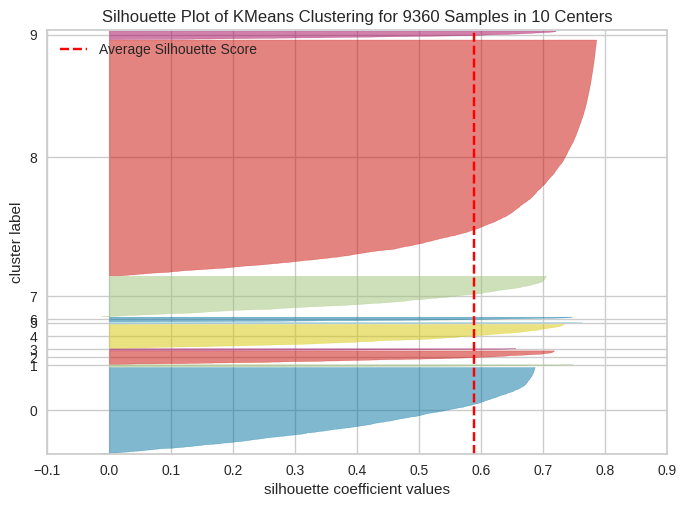

In [ ]:
# Instantiate the clustering model and visualiser
visualizer = SilhouetteVisualizer(model, colors='yellowbrick')

visualizer.fit(pca2_result)
visualizer.show();

We still have imbalance with one very large cluster but none of the clusters are below average score so we will create a scatterplot to visualise the 10 clusters.

In [ ]:
pca2_word2vec_raw_df

,PC1,PC2
0,9.328009,0.211956
1,8.402455,0.054775
2,8.330387,0.078561
3,7.915372,-0.104685
4,6.468690,0.207075
...,...,...
9355,-0.341446,0.009857
9356,-0.347871,-0.010820
9357,-0.292833,-0.005536
9358,-0.326456,-0.005992


In [ ]:
kmeans.labels_

array([11, 11, 11, ...,  4, 10, 10], dtype=int32)

In [ ]:
pca2_word2vec_raw_df['category'] = kmeans.labels_

In [ ]:
with open('2024-09-22_pca2_word2vec_raw_cat_df.pickle', 'wb') as f:
  pickle.dump(pca2_word2vec_raw_df, f)

In [ ]:
pca2_word2vec_raw_df

,PC1,PC2,category
0,9.328009,0.211956,11
1,8.402455,0.054775,11
2,8.330387,0.078561,11
3,7.915372,-0.104685,11
4,6.468690,0.207075,2
...,...,...,...
9355,-0.341446,0.009857,10
9356,-0.347871,-0.010820,10
9357,-0.292833,-0.005536,4
9358,-0.326456,-0.005992,10


#### 4.1.7 Scatterplot - 10 clusters

In [ ]:
# Get the words from the Word2Vec model
words = list(word2vec_model.wv.index_to_key)

# Define text values for each data point
text_values = [f'{i}: {word}' for i, word in zip(pca2_word2vec_raw_df.index, words)]

# Create Scatter trace for data points
trace0 = go.Scatter(
    x=pca2_word2vec_raw_df['PC1'],
    y=pca2_word2vec_raw_df['PC2'],
    text=text_values,
    mode='markers',
    marker=dict(
        color=Z,
        size=10,
        opacity=0.8,
        line=dict(
            color='black',
            width=1,
        )
    ),
    name='Data Points',
)

# Create Scatter trace for cluster centres
trace1 = go.Scatter(
    x=model.cluster_centers_[:, 0],
    y=model.cluster_centers_[:, 1],
    name='Cluster Centres',
    mode='markers',
    marker=dict(
        symbol='x',
        size=12,
        color='black',
    ),
)



In [ ]:
# Define data
data = [trace0, trace1]

# Define layout
layout = go.Layout(
    title='Word2Vec (PCA 2D and k-means clustering with 10 clusters)',
    xaxis=dict(title='PC 1'),
    yaxis=dict(title='PC 2'),
    legend=dict(
        font=dict(size=12),
        bordercolor='black',
        borderwidth=1,
    )
)


In [ ]:
# Create figure
fig = go.Figure(data=data, layout=layout)

# Show the figure
fig.show()

#### 4.1.8 Silhouette Plot - 15 clusters

In [ ]:
n_clusters = 15
model, Z = cluster(n_clusters)

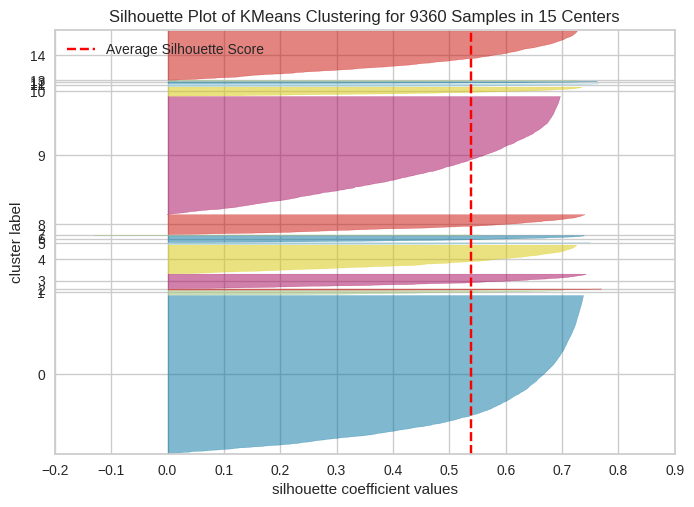

In [ ]:
# Instantiate the clustering model and visualiser
visualizer = SilhouetteVisualizer(model, colors='yellowbrick')

visualizer.fit(pca2_result)
visualizer.show();

The silhouette plot for 15 clusters again shows imbalance, albeit less, but has a lower average score than the 10 cluster plot. We will try t-SNE to see if it produces better results.

### 4.2 t-SNE - CBOW

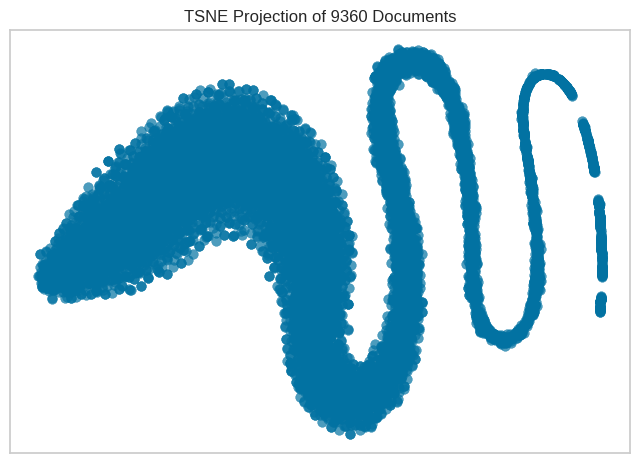

In [ ]:
# Create the visualiser and draw the vectors with perplexity=30
tsne = TSNEVisualizer(perplexity=30)
tsne.fit(X)
tsne.show();

In [ ]:
time_start = time.time()

tsne = TSNE(n_components=2, verbose=1, perplexity=30, n_iter=300)
tsne_results = tsne.fit_transform(X)

print(f't-SNE done! Time elapsed: {time.time()-time_start} seconds')

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 9360 samples in 0.001s...
[t-SNE] Computed neighbors for 9360 samples in 3.287s...
[t-SNE] Computed conditional probabilities for sample 1000 / 9360
[t-SNE] Computed conditional probabilities for sample 2000 / 9360
[t-SNE] Computed conditional probabilities for sample 3000 / 9360
[t-SNE] Computed conditional probabilities for sample 4000 / 9360
[t-SNE] Computed conditional probabilities for sample 5000 / 9360
[t-SNE] Computed conditional probabilities for sample 6000 / 9360
[t-SNE] Computed conditional probabilities for sample 7000 / 9360
[t-SNE] Computed conditional probabilities for sample 8000 / 9360
[t-SNE] Computed conditional probabilities for sample 9000 / 9360
[t-SNE] Computed conditional probabilities for sample 9360 / 9360
[t-SNE] Mean sigma: 0.016549
[t-SNE] KL divergence after 250 iterations with early exaggeration: 81.398613
[t-SNE] KL divergence after 300 iterations: 3.304188
t-SNE done! Time elapsed: 44.7448573112

In [ ]:
# Add the 2D output to a DataFrame
labels = ['t-SNE'+str(i) for i in range(1,3)]
tsne2_word2vec_raw_df = pd.DataFrame(tsne_results[:,0:2], columns=labels)

In [ ]:
with open('2024-09-22_tsne2_word2vec_raw_df.pickle', 'wb') as f:
  pickle.dump(tsne2_word2vec_raw_df, f)

In [ ]:
tsne2_word2vec_raw_df

,t-SNE1,t-SNE2
0,12.585490,-2.863662
1,12.585668,-2.867367
2,12.585664,-2.867332
3,12.585538,-2.864581
4,12.579989,-2.748503
...,...,...
9355,2.934229,-1.413931
9356,3.884856,-2.277470
9357,-1.949311,-4.124990
9358,-0.512250,0.104880


In [ ]:
wv_ind_to_key = list(word2vec_model.wv.index_to_key)

In [ ]:
with open('2024-09-22_wv_ind_to_key.pickle', 'wb') as f:
  pickle.dump(wv_ind_to_key, f)

#### 4.2.1 2D t-SNE scatterplot

In [ ]:
# Get the words from the Word2Vec model
words = list(word2vec_model.wv.index_to_key)

text_values = [f'{i}: {word}' for i, word in zip(tsne2_word2vec_raw_df.index, words)]

# Create a scatter plot trace
scatter_trace = go.Scatter(
    x=tsne2_word2vec_raw_df['t-SNE1'],
    y=tsne2_word2vec_raw_df['t-SNE2'],
    text=text_values,
    mode='markers',
    marker=dict(
        size=10,
        opacity=0.7,
        line=dict(
            color='black',
            width=2,
        )
    ),
)

# Create the layout
layout = go.Layout(
    title='2D t-SNE Plot',
    xaxis=dict(title='t-SNE 1'),
    yaxis=dict(title='t-SNE 2'),
    showlegend=False
)

# Create the figure
fig = go.Figure(data=[scatter_trace], layout=layout)

# Show the plot
fig.show()

#### 4.2.2 K-means raw vectors

In [ ]:
def cluster(n_clusters):
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(tsne_results)
    Z = kmeans.predict(tsne_results)
    return kmeans, Z

In [ ]:
max_clusters = 15

In [ ]:
inertias = np.zeros(max_clusters)

for i in range(1, max_clusters):
    kmeans, Z = cluster(i)
    inertias[i] = kmeans.inertia_

#### 4.2.3 Elbow method

In [ ]:
data_km = go.Scatter(
            x=list(range(1, max_clusters)),
            y=inertias[1:]
    )

layout_km = go.Layout(
    title='2D t-SNE Word2Vec raw vectors - Elbow method',
    xaxis=go.layout.XAxis(title='Number of clusters',
                   range=[0, max_clusters]),
    yaxis=go.layout.YAxis(title='Inertia')
)

fig0 = go.Figure(data=data_km, layout=layout_km)

In [ ]:
pyo.plot(fig0, filename='tsne2_word2vec-raw-article-text-clustering-inertias')

'tsne2_word2vec-raw-article-text-clustering-inertias.html'

In [ ]:
fig0.show(renderer="colab", filename='tsne2_word2vec-raw-article-text-clustering-inertias')

#### 4.2.4 Silhouette Plot - 5 clusters

In [ ]:
n_clusters = 5
model, Z = cluster(n_clusters)

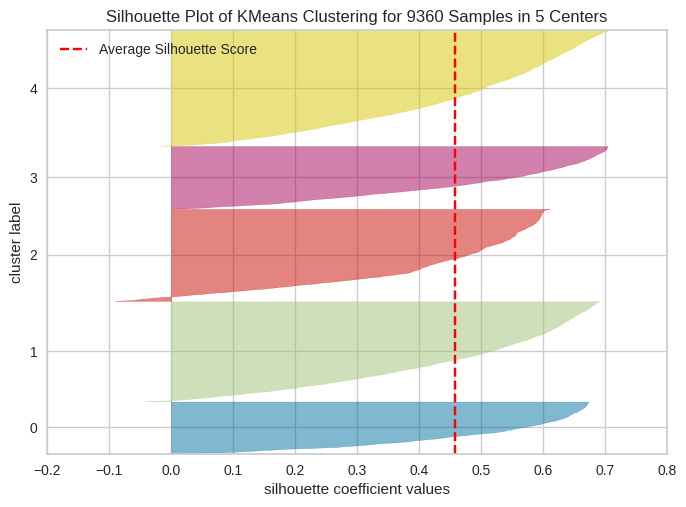

In [ ]:
# Instantiate the clustering model and visualiser
visualizer = SilhouetteVisualizer(model, colors='yellowbrick')

visualizer.fit(tsne_results)
visualizer.show();

In [ ]:
kmeans.labels_

array([10, 10, 10, ...,  9,  0,  7], dtype=int32)

In [ ]:
len(kmeans.labels_)

9360

In [ ]:
tsne2_word2vec_raw_df

,t-SNE1,t-SNE2
0,12.585490,-2.863662
1,12.585668,-2.867367
2,12.585664,-2.867332
3,12.585538,-2.864581
4,12.579989,-2.748503
...,...,...
9355,2.934229,-1.413931
9356,3.884856,-2.277470
9357,-1.949311,-4.124990
9358,-0.512250,0.104880


In [ ]:
tsne2_word2vec_raw_df['category'] = kmeans.labels_

In [ ]:
with open('2024-09-22_tsne2_word2vec_raw_cat_df.pickle', 'wb') as f:
  pickle.dump(tsne2_word2vec_raw_df, f)

In [ ]:
tsne2_word2vec_raw_df

,t-SNE1,t-SNE2,category
0,12.585490,-2.863662,10
1,12.585668,-2.867367,10
2,12.585664,-2.867332,10
3,12.585538,-2.864581,10
4,12.579989,-2.748503,10
...,...,...,...
9355,2.934229,-1.413931,12
9356,3.884856,-2.277470,7
9357,-1.949311,-4.124990,9
9358,-0.512250,0.104880,0


#### 4.2.5 Scatterplot - 5 clusters

In [ ]:
# Get the words from the Word2Vec model
words = list(word2vec_model.wv.index_to_key)

# Define text values for each data point
text_values = [f'{i}: {word}' for i, word in zip(tsne2_word2vec_raw_df.index, words)]

# Create Scatter trace for data points
trace0 = go.Scatter(
    x=tsne2_word2vec_raw_df['t-SNE1'],
    y=tsne2_word2vec_raw_df['t-SNE2'],
    text=text_values,
    mode='markers',
    marker=dict(
        color=Z,
        size=10,
        opacity=0.8,
        line=dict(
            color='black',
            width=1,
        )
    ),
    name='Data Points',
)

# Create Scatter trace for cluster centres
trace1 = go.Scatter(
    x=model.cluster_centers_[:, 0],
    y=model.cluster_centers_[:, 1],
    name='Cluster Centres',
    mode='markers',
    marker=dict(
        symbol='x',
        size=12,
        color='black',
    ),
)



In [ ]:
# Define data
data = [trace0, trace1]

# Define layout
layout = go.Layout(
    title='Word2Vec (t-SNE 2D and k-means clustering with 5 clusters)',
    xaxis=dict(title='t-SNE 1'),
    yaxis=dict(title='t-SNE 2'),
    legend=dict(
        font=dict(size=12),
        bordercolor='black',
        borderwidth=1,
    )
)


In [ ]:
# Create figure
fig = go.Figure(data=data, layout=layout)

# Show the figure
fig.show()

### 4.3 UMAP - CBOW

In [ ]:
!pip install umap-learn

In [ ]:
from umap import UMAP

In [ ]:
# Initialise and run UMAP
umap_2d = UMAP(n_components=2, n_neighbors=50, init='random', random_state=0)
umap_results = umap_2d.fit_transform(X)

# Add the 2D output to a DataFrame
labels = ['UMAP'+str(i) for i in range(1, 3)]
umap2_df = pd.DataFrame(umap_results[:,0:2], columns=labels)

In [ ]:
with open('2024-09-22_umap2_word2vec_raw_df.pickle', 'wb') as f:
  pickle.dump(umap2_df, f)

#### 4.3.1 2D UMAP scatterplot

In [ ]:
# Get the words from the Word2Vec model
words = list(word2vec_model.wv.index_to_key)

# Define text values for each data point
text_values = [f'{i}: {word}' for i, word in zip(umap2_df.index, words)]

# Create a scatter plot trace
scatter_trace = go.Scatter(
    x=umap2_df['UMAP1'],
    y=umap2_df['UMAP2'],
    text=text_values, # Include text annotations with article titles
    mode='markers',
    marker=dict(
        size=10,  # Adjust size of data points
        opacity=0.7,  # Set opacity of data points
        line=dict(
            color='black',
            width=2,
        )
    ),
)

# Create the layout
layout = go.Layout(
    title='2D UMAP Plot',
    xaxis=dict(title='UMAP 1'),
    yaxis=dict(title='UMAP 2'),
    showlegend=False
)

# Create the figure
fig = go.Figure(data=[scatter_trace], layout=layout)

# Show the plot
fig.show()

#### 4.3.2 K-means raw vectors

In [ ]:
def cluster(n_clusters):
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(umap_results)
    Z = kmeans.predict(umap_results)
    return kmeans, Z

In [ ]:
max_clusters = 15

In [ ]:
inertias = np.zeros(max_clusters)

for i in range(1, max_clusters):
    kmeans, Z = cluster(i)
    inertias[i] = kmeans.inertia_

#### 4.3.3 Elbow method

In [ ]:
data_km = go.Scatter(
            x=list(range(1, max_clusters)),
            y=inertias[1:]
    )

layout_km = go.Layout(
    title='2D UMAP Word2Vec raw vectors - Elbow method',
    xaxis=go.layout.XAxis(title='Number of clusters',
                   range=[0, max_clusters]),
    yaxis=go.layout.YAxis(title='Inertia')
)

fig0 = go.Figure(data=data_km, layout=layout_km)

In [ ]:
pyo.plot(fig0, filename='umap2_word2vec-raw-article-text-clustering-inertias')

'umap2_word2vec-raw-article-text-clustering-inertias.html'

In [ ]:
fig0.show(renderer="colab", filename='umap2_word2vec-raw-article-text-clustering-inertias')

#### 4.3.4 Silhouette Plot - 4 clusters

In [ ]:
n_clusters = 4
model, Z = cluster(n_clusters)

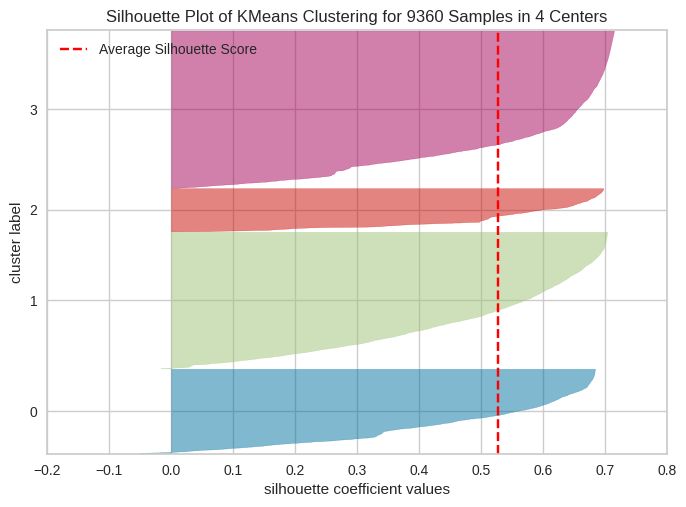

In [ ]:
# Instantiate the clustering model and visualiser
visualizer = SilhouetteVisualizer(model, colors='yellowbrick')

visualizer.fit(umap_results)  # Fit the data to the visualiser
visualizer.show();        # Finalise and render the figure

In [ ]:
umap2_df

,UMAP1,UMAP2
0,-9.391764,0.071239
1,-9.369896,0.048207
2,-9.374780,0.052917
3,-9.342682,0.020521
4,-9.508096,0.193149
...,...,...
9355,5.862096,-0.277124
9356,5.627174,-0.813147
9357,5.224494,3.057569
9358,5.568528,1.133614


In [ ]:
umap2_df['category'] = kmeans.labels_

In [ ]:
with open('2024-09-22_umap2_word2vec_raw_cat_df.pickle', 'wb') as f:
  pickle.dump(umap2_df, f)

#### 4.3.5 UMAP scatterplot - 4 clusters

In [ ]:
# Get the words from the Word2Vec model
words = list(word2vec_model.wv.index_to_key)

# Define text values for each data point
text_values = [f'{i}: {word}' for i, word in zip(umap2_df.index, words)]

# Create Scatter trace for data points
trace0 = go.Scatter(
    x=umap2_df['UMAP1'],
    y=umap2_df['UMAP2'],
    text=text_values,  # Use the generated text values
    mode='markers',
    marker=dict(
        color=Z,
        size=10,  # Adjust size of markers
        opacity=0.8,  # Set opacity of markers
        line=dict(
            color='black',  # Set colour of marker outline
            width=1,  # Set width of marker outline
        )
    ),
    name='Data Points',  # Set legend label for data points
)

# Create Scatter trace for cluster centers
trace1 = go.Scatter(
    x=model.cluster_centers_[:, 0],
    y=model.cluster_centers_[:, 1],
    name='Cluster Centres',  # Set legend label for cluster centres
    mode='markers',
    marker=dict(
        symbol='x',  # Set symbol for cluster centres
        size=12,  # Adjust size of cluster centre markers
        color='black',  # Set colour of cluster centre markers
    ),
)



In [ ]:
# Define data
data = [trace0, trace1]

# Define layout
layout = go.Layout(
    title='Word2Vec (UMAP 2D and k-means clustering with 4 clusters)',
    xaxis=dict(title='UMAP 1'),  # X-axis label
    yaxis=dict(title='UMAP 2'),  # Y-axis label
    legend=dict(
        font=dict(size=12),  # Adjust legend font size
        bordercolor='black',  # Set legend border colour
        borderwidth=1,  # Set legend border width
    )
)


In [ ]:
# Create figure
fig = go.Figure(data=data, layout=layout)

# Show the figure
fig.show()

## 5. Skip-gram model

The second model Word2Vec uses is the Skip-gram model so the boolean `sg` skip-gram parameter is set to `sg=1`. Other parameters have left the same as for the CBOW model.

The model is then trained using (target, context) pairs to minimise the  difference between the predicted context words and the actual context words.



In [ ]:
with open('2024-09-17_word_tok_sents.pickle', 'rb') as f:
    corpus = pickle.load(f)

In [ ]:
# Build vocabulary and Skip-gram Model with same parameters as CBOW model except sg=1
skipgram_model = Word2Vec(sentences=corpus, vector_size=100, window=10, min_count=1, workers=2, sg=1)

In [ ]:
# Summarise the loaded model
print(skipgram_model)

Word2Vec<vocab=9360, vector_size=100, alpha=0.025>


In [ ]:
# Summarise vocabulary
words = list(skipgram_model.wv.key_to_index)
print(words)

['drug', 'drugs', 'covid-19', 'sars-cov-2', 'repurposing', 'protein', 'data', 'studies', 'network', 'study', 'genes', 'disease', 'based', 'binding', 'target', 'proteins', 'potential', 'molecular', 'viral', 'research', 'analysis', 'targets', 'new', 'treatment', 'clinical', 'docking', 'compounds', 'virus', 'interactions', 'interaction', 'methods', 'approaches', 'gene', 'diseases', 'model', 'antiviral', 'human', 'repositioning', 'development', 'biological', 'information', 'results', 'host', 'discovery', 'different', 'in', 'identified', 's', 'use', 'repurposed', 'molecules', 'screening', 'learning', 'structure', 'networks', 'computational', 'approved', 'ligand', 'fda', 'active', 'patients', 'approach', 'shown', 'rdrp', 'complex', 'number', 'replication', 'known', 'activity', 'rna', 'time', 'method', 'trials', 'remdesivir', 'effects', 'expression', 'protease', 'set', 'high', 'cov', 'coronavirus', 'effective', 'models', 'cell', 'energy', 'novel', 'main', 'process', 'showed', 'including', 'fo

In [ ]:
# Access word embeddings
word = 'covid-19'
skipgram_embedding = skipgram_model.wv[word]

In [ ]:
# 100-dimensional raw embedding vector the model has learned during training
skipgram_embedding

array([-4.28737402e-01, -1.81770679e-02,  1.03676379e-01,  4.93232995e-01,
       -1.46357358e-01, -2.57119626e-01,  5.06959081e-01,  7.13564992e-01,
       -1.67757064e-01, -1.41745582e-01,  9.36551765e-02,  4.12944501e-04,
       -1.12743661e-01,  4.14678335e-01, -3.14052552e-02,  1.27213299e-01,
       -3.05766761e-01, -7.44835809e-02, -3.16782504e-01, -2.58467704e-01,
       -6.31493554e-02,  1.01228673e-02,  2.11387709e-01, -4.69554782e-01,
        1.54408917e-01,  1.25324830e-01, -9.07751396e-02, -1.94597971e-02,
       -1.62005424e-01,  1.01587780e-01,  4.30962741e-02, -1.42696768e-01,
        4.63098794e-01,  7.37602785e-02, -2.42371410e-01, -1.11977048e-01,
       -8.29408392e-02, -3.38335544e-01, -2.92129964e-01, -8.27733427e-02,
       -1.28086463e-01,  3.00031632e-01, -9.41133499e-02, -5.78616783e-02,
        6.21298067e-02, -1.19128838e-01,  1.07441708e-01,  1.15837669e-02,
       -7.23871514e-02, -3.91816348e-03,  4.20068979e-01, -1.31208435e-01,
        8.31738487e-03, -

In [ ]:
# single unit-normalised vector
skipgram_normed_vector = skipgram_model.wv.get_vector('covid-19', norm=True)
print(skipgram_normed_vector)

[-1.71363577e-01 -7.26525718e-03  4.14387807e-02  1.97142065e-01
 -5.84980957e-02 -1.02769062e-01  2.02628285e-01  2.85207331e-01
 -6.70514181e-02 -5.66547997e-02  3.74333709e-02  1.65051257e-04
 -4.50629182e-02  1.65744260e-01 -1.25524784e-02  5.08463383e-02
 -1.22213006e-01 -2.97706090e-02 -1.26615927e-01 -1.03307880e-01
 -2.52403915e-02  4.04604478e-03  8.44903067e-02 -1.87678024e-01
  6.17162511e-02  5.00915274e-02 -3.62822413e-02 -7.77795585e-03
 -6.47525266e-02  4.06039841e-02  1.72253046e-02 -5.70349805e-02
  1.85097605e-01  2.94815097e-02 -9.68742967e-02 -4.47565056e-02
 -3.31509188e-02 -1.35230541e-01 -1.16762467e-01 -3.30839716e-02
 -5.11953346e-02  1.19920716e-01 -3.76165025e-02 -2.31269412e-02
  2.48328838e-02 -4.76150326e-02  4.29437608e-02  4.62995702e-03
 -2.89326794e-02 -1.56606478e-03  1.67898864e-01 -5.24431691e-02
  3.32440529e-03 -1.20584786e-01  7.25125335e-03  2.16136575e-01
  9.51223373e-02 -3.58429849e-02 -1.64870787e-02 -1.04499310e-01
  1.84472784e-01  3.71044

In [ ]:
# save model
skipgram_model.save('skipgram_model.bin')

In [ ]:
# load model
skipgram_model = Word2Vec.load('skipgram_model.bin')
print(skipgram_model)

Word2Vec<vocab=9360, vector_size=100, alpha=0.025>


In [ ]:
print(skipgram_model.wv.vectors)

[[-0.1540358   0.02686811  0.20644473 ...  0.05314045 -0.01451982
   0.30517387]
 [-0.39388835  0.10767826  0.18686748 ... -0.07406652 -0.0487094
   0.08176639]
 [-0.4287374  -0.01817707  0.10367638 ... -0.02238205  0.18160728
  -0.17662838]
 ...
 [-0.07705612  0.01738206  0.03983543 ...  0.0103657   0.00529067
   0.07382188]
 [-0.17829682  0.04152546  0.07743948 ...  0.0243244  -0.01379171
   0.15265498]
 [-0.07324179  0.01408335  0.03925814 ...  0.01946547  0.00728764
   0.05777721]]


Return a `dict_keys` object with all the words (keys) in the vocabulary and their index.

In [ ]:
print(skipgram_model.wv.key_to_index)

{'drug': 0, 'drugs': 1, 'covid-19': 2, 'sars-cov-2': 3, 'repurposing': 4, 'protein': 5, 'data': 6, 'studies': 7, 'network': 8, 'study': 9, 'genes': 10, 'disease': 11, 'based': 12, 'binding': 13, 'target': 14, 'proteins': 15, 'potential': 16, 'molecular': 17, 'viral': 18, 'research': 19, 'analysis': 20, 'targets': 21, 'new': 22, 'treatment': 23, 'clinical': 24, 'docking': 25, 'compounds': 26, 'virus': 27, 'interactions': 28, 'interaction': 29, 'methods': 30, 'approaches': 31, 'gene': 32, 'diseases': 33, 'model': 34, 'antiviral': 35, 'human': 36, 'repositioning': 37, 'development': 38, 'biological': 39, 'information': 40, 'results': 41, 'host': 42, 'discovery': 43, 'different': 44, 'in': 45, 'identified': 46, 's': 47, 'use': 48, 'repurposed': 49, 'molecules': 50, 'screening': 51, 'learning': 52, 'structure': 53, 'networks': 54, 'computational': 55, 'approved': 56, 'ligand': 57, 'fda': 58, 'active': 59, 'patients': 60, 'approach': 61, 'shown': 62, 'rdrp': 63, 'complex': 64, 'number': 65, 

In [ ]:
sg_key_to_ind = skipgram_model.wv.key_to_index

In [ ]:
with open('2024-09-23_sg_key_to_ind.pickle', 'wb') as f:
  pickle.dump(sg_key_to_ind, f)

Fetch vectors for a word list.

In [ ]:
all_skipgram_vectors = []
for index, vector in enumerate(skipgram_model.wv.vectors):
    vector_object = {}
    vector_object[list(skipgram_model.wv.key_to_index)[index]] = vector
    all_skipgram_vectors.append(vector_object)

In [ ]:
all_skipgram_vectors

[{'drug': array([-0.1540358 ,  0.02686811,  0.20644473,  0.40328097, -0.3644286 ,
         -0.24096939,  0.6285167 ,  0.6729265 , -0.20800261, -0.22458364,
          0.18179494, -0.27066088, -0.20854093,  0.31763768, -0.12852849,
         -0.02443148, -0.14067905, -0.23341045, -0.3428934 , -0.54103565,
          0.19872494, -0.07549843,  0.1514121 , -0.09312447,  0.26932436,
          0.25250286, -0.27213126,  0.24347521, -0.08979617, -0.01464957,
         -0.11278123, -0.07555363,  0.71425164, -0.3532862 , -0.3902018 ,
         -0.01409874,  0.10662062, -0.37341505, -0.13398793, -0.30559012,
         -0.11011241,  0.1649438 , -0.16124043,  0.08616243, -0.05745959,
         -0.20279856, -0.14670976,  0.06906399, -0.02710559,  0.28210697,
          0.02665333, -0.2613395 , -0.11197857, -0.01661479,  0.21751928,
          0.4430552 ,  0.07982326, -0.1650026 ,  0.07187699,  0.07017843,
          0.23057543, -0.03739134, -0.11694919,  0.1278616 , -0.19611631,
          0.44112393, -0.20126

In [ ]:
print(all_skipgram_vectors[0:10])

[{'drug': array([-0.1540358 ,  0.02686811,  0.20644473,  0.40328097, -0.3644286 ,
       -0.24096939,  0.6285167 ,  0.6729265 , -0.20800261, -0.22458364,
        0.18179494, -0.27066088, -0.20854093,  0.31763768, -0.12852849,
       -0.02443148, -0.14067905, -0.23341045, -0.3428934 , -0.54103565,
        0.19872494, -0.07549843,  0.1514121 , -0.09312447,  0.26932436,
        0.25250286, -0.27213126,  0.24347521, -0.08979617, -0.01464957,
       -0.11278123, -0.07555363,  0.71425164, -0.3532862 , -0.3902018 ,
       -0.01409874,  0.10662062, -0.37341505, -0.13398793, -0.30559012,
       -0.11011241,  0.1649438 , -0.16124043,  0.08616243, -0.05745959,
       -0.20279856, -0.14670976,  0.06906399, -0.02710559,  0.28210697,
        0.02665333, -0.2613395 , -0.11197857, -0.01661479,  0.21751928,
        0.4430552 ,  0.07982326, -0.1650026 ,  0.07187699,  0.07017843,
        0.23057543, -0.03739134, -0.11694919,  0.1278616 , -0.19611631,
        0.44112393, -0.20126343,  0.22935073, -0.22522

In [ ]:
# retrieve all of the vectors for single unit-normalised vectors
X = skipgram_model.wv.get_normed_vectors()

In [ ]:
len(X)

9360

In [ ]:
X

array([[-0.0595787 ,  0.01039218,  0.07984967, ...,  0.02055391,
        -0.00561605,  0.11803659],
       [-0.15646219,  0.04277247,  0.07422838, ..., -0.02942105,
        -0.01934858,  0.03247963],
       [-0.17136358, -0.00726526,  0.04143878, ..., -0.00894596,
         0.07258726, -0.07059723],
       ...,
       [-0.14252174,  0.03214957,  0.07367896, ...,  0.01917223,
         0.00978554,  0.13653974],
       [-0.1685721 ,  0.03926056,  0.07321575, ...,  0.02299769,
        -0.01303948,  0.14432882],
       [-0.184953  ,  0.03556383,  0.0991362 , ...,  0.04915495,
         0.01840304,  0.14590126]], dtype=float32)

In [ ]:
with open('2024-09-23_sg_normed_vectors.pickle', 'wb') as f:
  pickle.dump(X, f)

In [ ]:
# And for raw vectors
X = skipgram_model.wv.vectors

In [ ]:
len(X)

9360

In [ ]:
X

array([[-0.1540358 ,  0.02686811,  0.20644473, ...,  0.05314045,
        -0.01451982,  0.30517387],
       [-0.39388835,  0.10767826,  0.18686748, ..., -0.07406652,
        -0.0487094 ,  0.08176639],
       [-0.4287374 , -0.01817707,  0.10367638, ..., -0.02238205,
         0.18160728, -0.17662838],
       ...,
       [-0.07705612,  0.01738206,  0.03983543, ...,  0.0103657 ,
         0.00529067,  0.07382188],
       [-0.17829682,  0.04152546,  0.07743948, ...,  0.0243244 ,
        -0.01379171,  0.15265498],
       [-0.07324179,  0.01408335,  0.03925814, ...,  0.01946547,
         0.00728764,  0.05777721]], dtype=float32)

In [ ]:
with open('2024-09-23_sg_raw_vectors.pickle', 'wb') as f:
  pickle.dump(X, f)

### 5.1 2D PCA - Skip-gram embeddings

We will plot the word embeddings after dimensionality reduction to two principal components.

In [ ]:
# create a list of all the words in the corpus
words = list(skipgram_model.wv.key_to_index)

We will load the data for the raw vectors first.

In [ ]:
with open('2024-09-23_sg_raw_vectors.pickle', 'rb') as f:
  X = pickle.load(f)

In [ ]:
# fit a 2d PCA model to the vectors
pca = PCA(n_components=2)
pca2_result = pca.fit_transform(X)

In [ ]:
with open('2024-09-23_sg_pca2_raw_vectors.pickle', 'wb') as f:
  pickle.dump(pca2_result, f)

#### 5.1.1 2D PCA Skip-gram raw vectors scatterplot

In [ ]:
# Create a list of strings containing x, y, and word for each point
hover_text = [f'Word: {word}<br>x: {x}<br>y: {y}' for word, x, y in zip(words, pca2_result[:, 0], pca2_result[:, 1])]

# Create a scatter plot
fig = go.Figure()

# Add scatter trace
fig.add_trace(go.Scatter(
    x=pca2_result[:, 0],
    y=pca2_result[:, 1],
    mode='markers',
    marker=dict(
        size=8,
    ),
    text=hover_text,  # Assign hover text
    hoverinfo='text',  # Set hoverinfo to show text on hover
))

# Update layout
fig.update_layout(
    title='2D Skip-gram Model Scatter Plot - Raw vectors',
    xaxis=dict(
        title='Principal Component 1',
        tickfont=dict(size=10),
    ),
    yaxis=dict(
        title='Principal Component 2',
        tickfont=dict(size=10),
    ),
    # width=800,
    # height=400,
)

# Show the plot
fig.show()

And compare the plot with normalised vectors.

In [ ]:
with open('2024-09-23_sg_normed_vectors.pickle', 'rb') as f:
  X = pickle.load(f)

In [ ]:
# fit a 2d PCA model to the vectors
pca = PCA(n_components=2)
pca2n_result = pca.fit_transform(X)

#### 5.1.2 2D PCA Skip-gram normalised vectors scatterplot

In [ ]:
# Create a list of strings containing x, y, and word for each point
hover_text = [f'Word: {word}<br>x: {x}<br>y: {y}' for word, x, y in zip(words, pca2n_result[:, 0], pca2n_result[:, 1])]

# Create a scatter plot
fig = go.Figure()

# Add scatter trace
fig.add_trace(go.Scatter(
    x=pca2n_result[:, 0],
    y=pca2n_result[:, 1],
    mode='markers',
    marker=dict(
        size=8,
    ),
    text=hover_text,  # Assign hover text
    hoverinfo='text',  # Set hoverinfo to show text on hover
))

# Update layout
fig.update_layout(
    title='2D Skip-gram Model Scatter Plot - Normalised vectors',
    xaxis=dict(
        title='Principal Component 1',
        tickfont=dict(size=10),
    ),
    yaxis=dict(
        title='Principal Component 2',
        tickfont=dict(size=10),
    ),
    # width=800,
    # height=400,
)

# Show the plot
fig.show()

As for the PCA CBOW normalised vectors, we can see that the Skip-gram normalised vectors look very different from the raw vectors when plotted.

#### 5.1.3 K-means Skip-gram raw vectors

In [ ]:
len(pca2_result)

9360

In [ ]:
def cluster(n_clusters):
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(pca2_result)
    Z = kmeans.predict(pca2_result)
    return kmeans, Z

In [ ]:
max_clusters = 15

In [ ]:
inertias = np.zeros(max_clusters)

for i in range(1, max_clusters):
    kmeans, Z = cluster(i)
    inertias[i] = kmeans.inertia_

#### 5.1.4 Elbow method

In [ ]:
data_km = go.Scatter(
            x=list(range(1, max_clusters)),
            y=inertias[1:]
    )

layout_km = go.Layout(
    title='2D PCA Skip-gram raw vectors - Elbow method',
    xaxis=go.layout.XAxis(title='Number of clusters',
                   range=[0, max_clusters]),
    yaxis=go.layout.YAxis(title='Inertia')
)

fig0 = go.Figure(data=data_km, layout=layout_km)

In [ ]:
pyo.plot(fig0, filename='pca2_sg-raw-article-text-clustering-inertias')

'pca2_sg-raw-article-text-clustering-inertias.html'

In [ ]:
fig0.show(renderer="colab", filename='pca2_sg-raw-article-text-clustering-inertias')

#### 5.1.5 Silhouette Plot - 4 clusters

In [ ]:
from yellowbrick.cluster import SilhouetteVisualizer

In [ ]:
n_clusters = 4
model, Z = cluster(n_clusters)

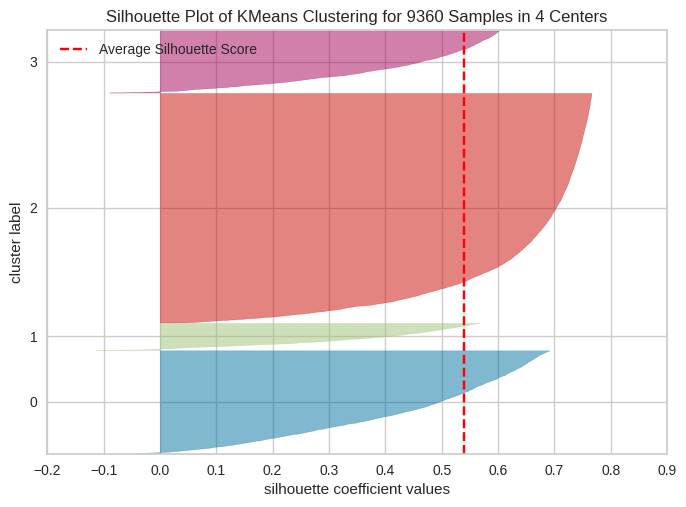

In [ ]:
# Instantiate the clustering model and visualiser
visualizer = SilhouetteVisualizer(model, colors='yellowbrick')

visualizer.fit(pca2_result)  # Fit the data to the visualiser
visualizer.show();        # Finalise and render the figure

### 5.2 t-SNE - Skip-gram

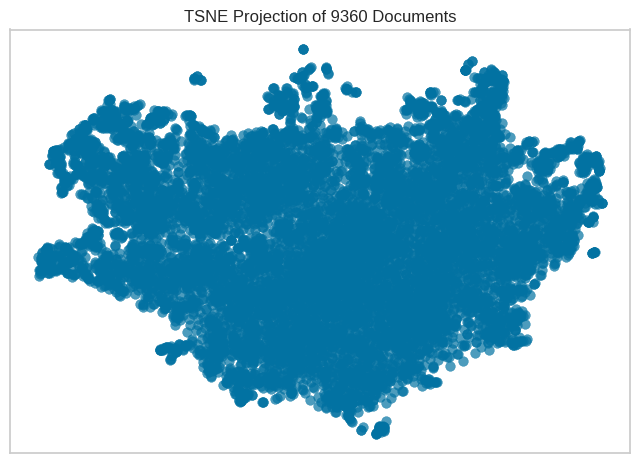

In [ ]:
# Create the visualizer and draw the vectors with perplexity=30
tsne = TSNEVisualizer(perplexity=30)
tsne.fit(X)
tsne.show();

In [ ]:
time_start = time.time()

tsne = TSNE(n_components=2, verbose=1, perplexity=30, n_iter=300)
tsne_results = tsne.fit_transform(X)

print(f't-SNE done! Time elapsed: {time.time()-time_start} seconds')

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 9360 samples in 0.001s...
[t-SNE] Computed neighbors for 9360 samples in 3.966s...
[t-SNE] Computed conditional probabilities for sample 1000 / 9360
[t-SNE] Computed conditional probabilities for sample 2000 / 9360
[t-SNE] Computed conditional probabilities for sample 3000 / 9360
[t-SNE] Computed conditional probabilities for sample 4000 / 9360
[t-SNE] Computed conditional probabilities for sample 5000 / 9360
[t-SNE] Computed conditional probabilities for sample 6000 / 9360
[t-SNE] Computed conditional probabilities for sample 7000 / 9360
[t-SNE] Computed conditional probabilities for sample 8000 / 9360
[t-SNE] Computed conditional probabilities for sample 9000 / 9360
[t-SNE] Computed conditional probabilities for sample 9360 / 9360
[t-SNE] Mean sigma: 0.026548
[t-SNE] KL divergence after 250 iterations with early exaggeration: 87.465919
[t-SNE] KL divergence after 300 iterations: 3.175324
t-SNE done! Time elapsed: 73.2447226047

In [ ]:
# Add the 2D output to a DataFrame
labels = ['t-SNE'+str(i) for i in range(1,3)]
tsne2_sg_raw_df = pd.DataFrame(tsne_results[:,0:2], columns=labels)

In [ ]:
with open('2024-09-23_tsne2_sg_raw_df.pickle', 'wb') as f:
  pickle.dump(tsne2_sg_raw_df, f)

In [ ]:
tsne2_sg_raw_df

,t-SNE1,t-SNE2
0,-6.296224,7.658805
1,-4.648126,7.912284
2,-3.929733,7.918543
3,1.962132,8.810305
4,-6.865293,7.421812
...,...,...
9355,6.737035,-0.373715
9356,6.953570,2.464390
9357,6.709271,-2.459107
9358,8.604641,2.130742


#### 5.2.1 2D t-SNE scatterplot

In [ ]:
# Get the words from the Word2Vec model
words = list(skipgram_model.wv.index_to_key)

text_values = [f'{i}: {word}' for i, word in zip(tsne2_sg_raw_df.index, words)]

# Create a scatter plot trace
scatter_trace = go.Scatter(
    x=tsne2_sg_raw_df['t-SNE1'],
    y=tsne2_sg_raw_df['t-SNE2'],
    text=text_values, # Include text annotations with article titles
    mode='markers',
    marker=dict(
        size=10,  # Adjust size of data points
        opacity=0.7,  # Set opacity of data points
        line=dict(
            color='black',
            width=2,
        )
    ),
)

# Create the layout
layout = go.Layout(
    title='2D Skip-gram t-SNE Plot',
    xaxis=dict(title='t-SNE 1'),
    yaxis=dict(title='t-SNE 2'),
    showlegend=False
)

# Create the figure
fig = go.Figure(data=[scatter_trace], layout=layout)

# Show the plot
fig.show()

#### 5.2.2 K-means raw vectors

In [ ]:
def cluster(n_clusters):
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(tsne_results)
    Z = kmeans.predict(tsne_results)
    return kmeans, Z

In [ ]:
max_clusters = 15

In [ ]:
inertias = np.zeros(max_clusters)

for i in range(1, max_clusters):
    kmeans, Z = cluster(i)
    inertias[i] = kmeans.inertia_

#### 5.2.3 Elbow method

In [ ]:
data_km = go.Scatter(
            x=list(range(1, max_clusters)),
            y=inertias[1:]
    )

layout_km = go.Layout(
    title='2D t-SNE Skip-gram raw vectors - Elbow method',
    xaxis=go.layout.XAxis(title='Number of clusters',
                   range=[0, max_clusters]),
    yaxis=go.layout.YAxis(title='Inertia')
)

fig0 = go.Figure(data=data_km, layout=layout_km)

In [ ]:
pyo.plot(fig0, filename='tsne2_sg-raw-article-text-clustering-inertias')

'tsne2_sg-raw-article-text-clustering-inertias.html'

In [ ]:
fig0.show(renderer="colab", filename='tsne2_sg-raw-article-text-clustering-inertias')

#### 5.2.4 Silhouette Plot - 4 clusters

In [ ]:
n_clusters = 4
model, Z = cluster(n_clusters)

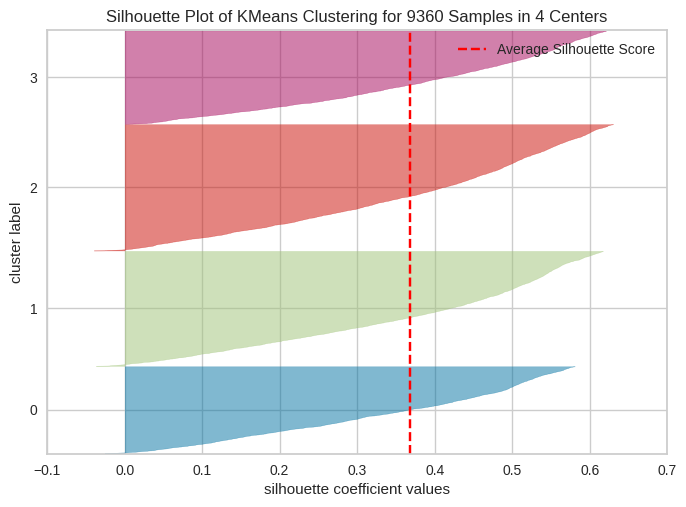

In [ ]:
# Instantiate the clustering model and visualiser
visualizer = SilhouetteVisualizer(model, colors='yellowbrick')

visualizer.fit(tsne_results)  # Fit the data to the visualiser
visualizer.show();        # Finalise and render the figure

In [ ]:
kmeans.labels_

array([ 0,  0,  0, ...,  1, 13,  6], dtype=int32)

In [ ]:
len(kmeans.labels_)

9360

In [ ]:
tsne2_sg_raw_df

,t-SNE1,t-SNE2
0,-6.296224,7.658805
1,-4.648126,7.912284
2,-3.929733,7.918543
3,1.962132,8.810305
4,-6.865293,7.421812
...,...,...
9355,6.737035,-0.373715
9356,6.953570,2.464390
9357,6.709271,-2.459107
9358,8.604641,2.130742


In [ ]:
tsne2_sg_raw_df['category'] = kmeans.labels_

In [ ]:
with open('2024-09-23_tsne2_sg_raw_cat_df.pickle', 'wb') as f:
  pickle.dump(tsne2_sg_raw_df, f)

In [ ]:
tsne2_sg_raw_df

,t-SNE1,t-SNE2,category
0,-6.296224,7.658805,0
1,-4.648126,7.912284,0
2,-3.929733,7.918543,0
3,1.962132,8.810305,3
4,-6.865293,7.421812,12
...,...,...,...
9355,6.737035,-0.373715,13
9356,6.953570,2.464390,8
9357,6.709271,-2.459107,1
9358,8.604641,2.130742,13


#### 5.2.5 Scatterplot - 4 clusters

In [ ]:
# Get the words from the Word2Vec model
words = list(skipgram_model.wv.index_to_key)

# Define text values for each data point
text_values = [f'{i}: {word}' for i, word in zip(tsne2_sg_raw_df.index, words)]

# Create Scatter trace for data points
trace0 = go.Scatter(
    x=tsne2_sg_raw_df['t-SNE1'],
    y=tsne2_sg_raw_df['t-SNE2'],
    text=text_values,  # Use the generated text values
    mode='markers',
    marker=dict(
        color=Z,
        size=10,  # Adjust size of markers
        opacity=0.8,  # Set opacity of markers
        line=dict(
            color='black',  # Set colour of marker outline
            width=1,  # Set width of marker outline
        )
    ),
    name='Data Points',  # Set legend label for data points
)

# Create Scatter trace for cluster centres
trace1 = go.Scatter(
    x=model.cluster_centers_[:, 0],
    y=model.cluster_centers_[:, 1],
    name='Cluster Centres',  # Set legend label for cluster centres
    mode='markers',
    marker=dict(
        symbol='x',  # Set symbol for cluster centres
        size=12,  # Adjust size of cluster centre markers
        color='black',  # Set colour of cluster centre markers
    ),
)



In [ ]:
# Define data
data = [trace0, trace1]

# Define layout
layout = go.Layout(
    title='Skip-gram (t-SNE 2D and k-means clustering with 4 clusters)',
    xaxis=dict(title='t-SNE 1'),  # X-axis label
    yaxis=dict(title='t-SNE 2'),  # Y-axis label
    legend=dict(
        font=dict(size=12),  # Adjust legend font size
        bordercolor='black',  # Set legend border colour
        borderwidth=1,  # Set legend border width
    )
)


In [ ]:
# Create figure
fig = go.Figure(data=data, layout=layout)

# Show the figure
fig.show()

### 5.3 UMAP - Skip-gram

In [ ]:
# Initialise and run UMAP
umap_2d = UMAP(n_components=2, n_neighbors=50, init='random', random_state=0)
umap_results = umap_2d.fit_transform(X)

# Add the 2D output to a DataFrame
labels = ['UMAP'+str(i) for i in range(1, 3)]
umap2_sg_raw_df = pd.DataFrame(umap_results[:,0:2], columns=labels)

In [ ]:
with open('2024-09-23_umap2_sg_raw_df.pickle', 'wb') as f:
  pickle.dump(umap2_sg_raw_df, f)

#### 5.3.1 2D Skip-gram UMAP scatterplot

In [ ]:
# Get the words from the Word2Vec model
words = list(skipgram_model.wv.index_to_key)

# Define text values for each data point
text_values = [f'{i}: {word}' for i, word in zip(umap2_sg_raw_df.index, words)]

# Create a scatter plot trace
scatter_trace = go.Scatter(
    x=umap2_sg_raw_df['UMAP1'],
    y=umap2_sg_raw_df['UMAP2'],
    text=text_values, # Include text annotations with article titles
    mode='markers',
    marker=dict(
        size=10,  # Adjust size of data points
        opacity=0.7,  # Set opacity of data points
        line=dict(
            color='black',
            width=2,
        )
    ),
)

# Create the layout
layout = go.Layout(
    title='2D Skip-gram UMAP Plot',
    xaxis=dict(title='UMAP 1'),
    yaxis=dict(title='UMAP 2'),
    showlegend=False
)

# Create the figure
fig = go.Figure(data=[scatter_trace], layout=layout)

# Show the plot
fig.show()

#### 5.3.2 K-means Skip-gram raw vectors

In [ ]:
def cluster(n_clusters):
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(umap_results)
    Z = kmeans.predict(umap_results)
    return kmeans, Z

In [ ]:
max_clusters = 15

In [ ]:
inertias = np.zeros(max_clusters)

for i in range(1, max_clusters):
    kmeans, Z = cluster(i)
    inertias[i] = kmeans.inertia_

#### 5.3.3 Elbow method - Skip-gram

In [ ]:
data_km = go.Scatter(
            x=list(range(1, max_clusters)),
            y=inertias[1:]
    )

layout_km = go.Layout(
    title='2D UMAP Slip-gram raw vectors - Elbow method',
    xaxis=go.layout.XAxis(title='Number of clusters',
                   range=[0, max_clusters]),
    yaxis=go.layout.YAxis(title='Inertia')
)

fig0 = go.Figure(data=data_km, layout=layout_km)

In [ ]:
pyo.plot(fig0, filename='umap2_skipgram-raw-article-text-clustering-inertias')

'umap2_skipgram-raw-article-text-clustering-inertias.html'

In [ ]:
fig0.show(renderer="colab", filename='umap2_skipgram-raw-article-text-clustering-inertias')

#### 5.3.4 Silhouette Plot - 4 clusters

In [ ]:
n_clusters = 4
model, Z = cluster(n_clusters)

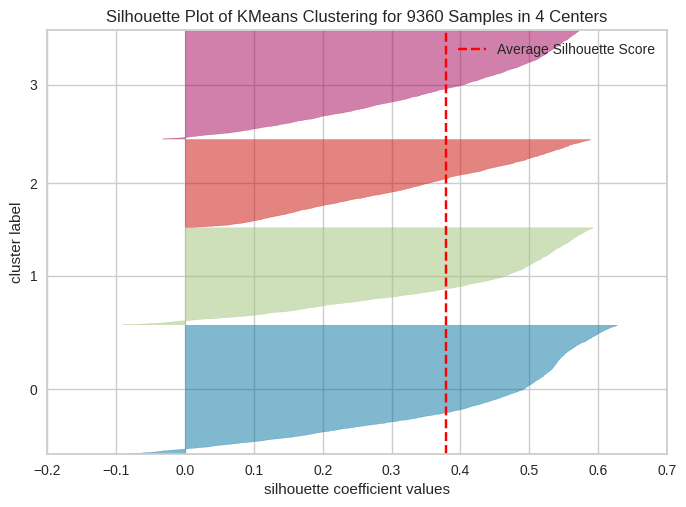

In [ ]:
# Instantiate the clustering model and visualiser
visualizer = SilhouetteVisualizer(model, colors='yellowbrick')

visualizer.fit(umap_results)  # Fit the data to the visualiser
visualizer.show();        # Finalise and render the figure

We can see that when k=4 the clusters are balanced, having similar sizes, and all extend beyond the dashed line for the overall silhouette score.

In [ ]:
umap2_sg_raw_df

,UMAP1,UMAP2
0,9.615035,3.713187
1,9.025751,3.904205
2,8.755067,4.062647
3,-0.449432,0.720232
4,9.827558,3.596234
...,...,...
9355,2.275455,-1.441355
9356,1.616489,-0.866536
9357,2.917238,-1.670658
9358,1.059615,-1.525357


In [ ]:
umap2_sg_raw_df['category'] = kmeans.labels_

In [ ]:
with open('2024-09-23_umap2_sg_raw_cat_df.pickle', 'wb') as f:
  pickle.dump(umap2_sg_raw_df, f)

#### 5.3.5 UMAP Skip-gram scatterplot - 4 clusters

In [ ]:
# Get the words from the Skip-gram model
words = list(skipgram_model.wv.index_to_key)

# Define text values for each data point
text_values = [f'{i}: {word}' for i, word in zip(umap2_sg_raw_df.index, words)]

# Create Scatter trace for data points
trace0 = go.Scatter(
    x=umap2_sg_raw_df['UMAP1'],
    y=umap2_sg_raw_df['UMAP2'],
    text=text_values,  # Use the generated text values
    mode='markers',
    marker=dict(
        color=Z,
        size=10,  # Adjust size of markers
        opacity=0.8,  # Set opacity of markers
        line=dict(
            color='black',  # Set colour of marker outline
            width=1,  # Set width of marker outline
        )
    ),
    name='Data Points',  # Set legend label for data points
)

# Create Scatter trace for cluster centres
trace1 = go.Scatter(
    x=model.cluster_centers_[:, 0],
    y=model.cluster_centers_[:, 1],
    name='Cluster Centres',  # Set legend label for cluster centres
    mode='markers',
    marker=dict(
        symbol='x',  # Set symbol for cluster centers
        size=12,  # Adjust size of cluster centre markers
        color='black',  # Set colour of cluster centre markers
    ),
)



In [ ]:
# Define data
data = [trace0, trace1]

# Define layout
layout = go.Layout(
    title='Skip-gram (UMAP 2D and k-means clustering with 4 clusters)',
    xaxis=dict(title='UMAP 1'),
    yaxis=dict(title='UMAP 2'),
    legend=dict(
        font=dict(size=12),  # Adjust legend font size
        bordercolor='black',  # Set legend border colour
        borderwidth=1,  # Set legend border width
    )
)


In [ ]:
# Create figure
fig = go.Figure(data=data, layout=layout)

# Show the figure
fig.show()

As expected, with UMAP the four clusters for the Skip-gram model are balanced and cohesive - a very different looking distribution from the CBOW clusters below.

In [ ]:
# Create figure
fig = go.Figure(data=data, layout=layout)

# Show the figure
fig.show()

## 6. 2D scatterplot comparing CBOW and Skip-gram embeddings - t-SNE + PCA

We will compare the t-SNE plots for CBOW and Skip-gram embeddings using PCA (a dense decomposition method) upon initialisation, to suppress some noise and speed up the computation of pairwise distances between samples.

In [ ]:
def plot_embeddings_plotly(model, title):
    labels = model.wv.index_to_key
    vectors = np.array([model.wv[word] for word in labels])  # Convert list to numpy array

    # Apply t-SNE for dimensionality reduction
    tsne_model = TSNE(perplexity=50, n_components=2, init='pca', n_iter=300, random_state=42)
    new_values = tsne_model.fit_transform(vectors)

    # Create a DataFrame to store the x, y coordinates and labels
    df = pd.DataFrame(new_values, columns=['x', 'y'])
    df['word'] = labels

    # Plot with Plotly
    fig = go.Figure(data=go.Scatter(
        x=df['x'],
        y=df['y'],
        mode='markers',
        text=df['word'],  # Labels for each word
        marker=dict(
            size=10,  # Adjust size of markers
            opacity=0.8,  # Set opacity of markers
            line=dict(
                color='black',  # Set colour of marker outline
                width=1,  # Set width of marker outline
            ),
        ),
    ))

    # Update the layout for better readability of word labels
    fig.update_layout(
        title=title,
        height=600,
        width=800,
        xaxis_title='TSNE Component 1',
        yaxis_title='TSNE Component 2',
        title_font=dict(size=20),
        showlegend=False
    )

    fig.show()

# Plot embeddings for different models
plot_embeddings_plotly(word2vec_model, 'CBOW Embeddings')
plot_embeddings_plotly(skipgram_model, 'Skipgram Embeddings')

## 7. GloVe

Another famous word representation algorithm is Stanford's Global Vectors for Word Representation (GloVe), proposed by [Pennington et al](https://nlp.stanford.edu/pubs/glove.pdf) in 2014, which combines the advantages of global matrix factorisation (such as the statistical LSA model) and local context window methods (such as Word2Vec's skip-gram model), and addresses the shortcomings. LSA performs poorly on syntactic and semantic understanding, and although Word2Vec is better at this, it focuses on local context window knowledge instead of global statistical information.

GloVe is a count-based machine learning model that creates the global co-occurrence matrix from the corpus as the first step, followed by the factorisation to get meaningful vector representations. It encodes syntactic and semantic relationships providing a holistic view of word meanings based on usage patterns, performing well on word analogy and similarity.  





In [ ]:
!pip install glove-python3

In [ ]:
from glove import Corpus, Glove

In [ ]:
# Function to train GloVe model
def train_glove(data):
    corpus = Corpus()  # Create a Corpus object
    corpus.fit(data, window=10)  # Fit the corpus with the tokenised data

    # Initialise the Glove model
    glove = Glove(no_components=100, learning_rate=0.05)

    # Fit the GloVe model on the corpus matrix
    glove.fit(corpus.matrix, epochs=30, no_threads=2, verbose=True)

    # Add dictionary to the model (maps words to their indices)
    glove.add_dictionary(corpus.dictionary)

    return glove

In [ ]:
# Train GloVe model
glove_model = train_glove(corpus)

Performing 30 training epochs with 2 threads
Epoch 0
Epoch 1
Epoch 2
Epoch 3
Epoch 4
Epoch 5
Epoch 6
Epoch 7
Epoch 8
Epoch 9
Epoch 10
Epoch 11
Epoch 12
Epoch 13
Epoch 14
Epoch 15
Epoch 16
Epoch 17
Epoch 18
Epoch 19
Epoch 20
Epoch 21
Epoch 22
Epoch 23
Epoch 24
Epoch 25
Epoch 26
Epoch 27
Epoch 28
Epoch 29


In [ ]:
# Extract words from the GloVe model's dictionary
words = list(glove_model.dictionary.keys())
print(words)

['sir', 'james', 'black', 'winner', 'nobel', 'prize', 'clearly', 'recognized', '21st', 'century', 'drug', 'repurposing', 'strategies', 'occupy', 'important', 'place', 'future', 'new', 'discovery', 'ted', 't.', 'ashburn', 'summarized', 'previous', 'research', 'developed', 'general', 'approach', 'development', 'retrospectively', 'looking', 'indications', 'approved', 'drugs', 'molecules', 'waiting', 'approval', 'pathways', 'action', 'targets', 'usually', 'safe', 'clinical', 'trials', 'sufficient', 'efficacy', 'treatment', 'disease', 'originally', 'targeted', 'definition', 'term', 'endorsed', 'scholars', 'pointed', 'synonyms', 'academics', 'include', 'repositioning', 'rediscovery', 'redirecting', 'retasking', 'therapeutic', 'switching', 'study', 'allarakhia', 'expanded', 'starting', 'materials', 'products', 'discontinued', 'commercial', 'reasons', 'expired', 'patents', 'candidates', 'laboratory', 'testing', 'process', 'completely', 'difficulty', 'lies', 'safety', 'main', 'potential', 'caus

In [ ]:
# Access word vectors for a specific word
word = 'covid-19'
glove_embedding = glove_model.word_vectors[glove_model.dictionary['word']]

In [ ]:
glove_embedding

array([ 4.25560596e-03, -2.83955099e-03, -3.21289663e-03, -4.90709224e-03,
       -3.52760812e-03,  4.11090754e-03, -1.53645270e-03, -2.90561781e-03,
       -3.11967338e-03, -2.15228270e-03, -1.34522205e-03,  1.90097099e-03,
       -2.08710005e-03,  2.62735930e-05, -1.26682721e-03, -1.59146188e-04,
       -9.66513562e-04, -3.11548895e-03,  1.70338562e-04, -2.32940491e-03,
       -4.68714142e-03, -3.23777781e-03, -8.34777060e-04,  1.50621474e-03,
        2.16201448e-03,  2.15995333e-03,  4.83054286e-04, -2.29827742e-03,
        2.83661654e-04,  1.02414115e-03, -1.21126534e-03, -2.60803784e-03,
        2.94798324e-04,  2.38355917e-03,  1.73293073e-04, -9.91864969e-04,
        9.45603577e-05, -1.36160233e-03,  1.56268915e-03,  3.59078964e-03,
       -4.60059031e-03, -1.31939792e-03, -3.66253661e-04,  1.21883844e-03,
       -1.45547430e-03,  2.42964103e-03,  3.21993358e-03,  2.25794147e-03,
       -3.37411034e-03, -1.84501487e-03,  3.11379000e-03, -3.45666268e-03,
       -2.24528415e-03, -

In [ ]:
# Save GloVe model
with open('2024-09-18_glove_model.pickle', 'wb') as f:
    pickle.dump(glove_model, f)

We will calculate the cosine similarity for all words and return the top *n* most similar words.

In [ ]:
# find the top-n most similar words to the target word
def find_most_similar(glove_model, word, top_n=10):
    word_idx = glove_model.dictionary[word]
    word_vector = glove_model.word_vectors[word_idx]
    similarities = {w: np.dot(word_vector, glove_model.word_vectors[i]) / (np.linalg.norm(word_vector) * np.linalg.norm(glove_model.word_vectors[i]))
                    for w, i in glove_model.dictionary.items() if w != word}
    return sorted(similarities.items(), key=lambda item: item[1], reverse=True)[:top_n]

In [ ]:
most_similar_words = find_most_similar(glove_model, 'drug', top_n=10)

for word, similarity in most_similar_words:
    print((word, similarity))

('discovery', 0.9926433728510291)
('design', 0.9863828073789505)
('aforementioned', 0.9858392189283104)
('discover', 0.981808072340848)
('traditional', 0.9806462277888506)
('reprofiling', 0.980140686962461)
('accelerate', 0.9786363246736541)
('repositioning', 0.9776505577159764)
('cost', 0.9764595262101597)
('link', 0.9750485036320506)


In [ ]:
most_similar_words = find_most_similar(glove_model, 'covid-19', top_n=10)

for word, similarity in most_similar_words:
    print((word, similarity))

('patients', 0.9887590997611241)
('treatment', 0.9794188313846268)
('pandemic', 0.9680748432972752)
('symptoms', 0.9645266172187784)
('cases', 0.9628928152012783)
('moderate', 0.9571570275846304)
('hospitalized', 0.9538879176708033)
('datasets', 0.9482030379203056)
('hospitalised', 0.9402334410084117)
('potency', 0.9312023994526555)


In [ ]:
most_similar_words = find_most_similar(glove_model, 'vaccine', top_n=10)

for word, similarity in most_similar_words:
    print((word, similarity))

('repurposing', 0.9586128049915671)
('strategies', 0.9496617154517504)
('future', 0.9494907300472185)
('opportunities', 0.9488270396576385)
('strategy', 0.9482081097062106)
('widely', 0.9466336487613338)
('alternative', 0.9465962898423875)
('indication', 0.9436597044267749)
('switching', 0.943158545226497)
('challenges', 0.942819500017332)


In [ ]:
# Extract word vectors from the glove model
X = glove_model.word_vectors

In [ ]:
len(X)

9360

In [ ]:
X

array([[ 0.00320151, -0.00597545,  0.00692705, ...,  0.00836923,
        -0.00076549,  0.00689451],
       [ 0.00718373, -0.00623673,  0.00960665, ...,  0.0164413 ,
        -0.00078362,  0.00792906],
       [ 0.00529221, -0.0117749 ,  0.0273361 , ...,  0.03176071,
        -0.01634749,  0.01735278],
       ...,
       [-0.00191295, -0.0144262 ,  0.02654107, ...,  0.03577165,
        -0.0155812 ,  0.02084316],
       [-0.00367351, -0.00798121,  0.02344214, ...,  0.02912762,
        -0.01497196,  0.01440477],
       [ 0.00434512, -0.00527156,  0.00184759, ...,  0.00937283,
        -0.00789066,  0.00221002]])

### 7.1 GloVe 2D PCA scatterplot

In [ ]:
# Apply PCA to reduce the dimensions to 2 components
pca = PCA(n_components=2)
result = pca.fit_transform(X)

In [ ]:
# Create a list of strings containing x, y, and word for each point
hover_text = [f'Word: {word}<br>x: {x}<br>y: {y}' for word, x, y in zip(words, result[:, 0], result[:, 1])]

# Create a scatter plot
fig = go.Figure()

# Add scatter trace
fig.add_trace(go.Scatter(
    x=result[:, 0],
    y=result[:, 1],
    mode='markers',
    marker=dict(
        size=8,
        opacity=0.8,
        line=dict(
        color='black',
        width=1,
        ),
    ),
    text=hover_text,
    hoverinfo='text',
))

# Update layout
fig.update_layout(
    title='2D PCA GloVe Model Scatter Plot',
    xaxis=dict(
        title='Principal Component 1',
        tickfont=dict(size=10),
    ),
    yaxis=dict(
        title='Principal Component 2',
        tickfont=dict(size=10),
    ),
)

# Show the plot
fig.show()

In [ ]:
# Create a list of strings containing x, y, and word for each point
hover_text = [f'Word: {word}<br>x: {x}<br>y: {y}' for word, x, y in zip(words, result[:, 0], result[:, 1])]

# Create a scatter plot
fig = go.Figure()

# Add scatter trace
fig.add_trace(go.Scatter(
    x=result[:, 0],
    y=result[:, 1],
    mode='markers',
    marker=dict(
        size=8,
    ),
    text=hover_text,
    hoverinfo='text',
))

# Update layout
fig.update_layout(
    title='2D PCA GloVe Model Scatter Plot',
    xaxis=dict(
        title='Principal Component 1',
        tickfont=dict(size=10),
    ),
    yaxis=dict(
        title='Principal Component 2',
        tickfont=dict(size=10),
    ),
)

# Show the plot
fig.show()

### 7.3 GloVe 3D PCA scatterplot

In [ ]:
# fit a 3d PCA model to the vectors
pca = PCA(n_components=3)
transformed = pca.fit_transform(X)

df = pd.DataFrame(transformed, columns=['x', 'y', 'z'])
df['word'] = words
df

,x,y,z,word
0,-0.020471,0.012225,0.005044,sir
1,-0.044221,0.018847,0.009196,james
2,-0.108389,0.000359,0.017987,black
3,-0.054235,0.021053,0.009117,winner
4,-0.063577,0.018262,0.009460,nobel
...,...,...,...,...
9355,-0.017344,-0.019430,0.011127,cpy450
9356,-0.052848,-0.008447,-0.019037,etc..
9357,-0.118554,0.003625,-0.011742,pros
9358,-0.086966,-0.000345,-0.007346,cons


In [ ]:
fig = px.scatter_3d(
    df, x='x', y='y', z='z',
    title='3D PCA GloVe Model Scatter Plot',
    text='word',
    labels={'x': 'PC 1', 'y': 'PC 2', 'z': 'PC 3'},
    width=800, height=800)

fig.update_traces(marker_size=5)

fig.show()

### 7.4 GloVe 2D t-SNE scatterplot

In [ ]:
# Fit and transform the word vectors to 2D space using t-SNE
tsne_model = TSNE(perplexity=40, n_components=2, init='pca', n_iter=300, random_state=42)
reduced_embeddings = tsne_model.fit_transform(X)

In [ ]:
# Create a DataFrame for plotting
df = pd.DataFrame(reduced_embeddings, columns=['x', 'y'])
df['word'] = words
df

,x,y,word
0,1.832873,4.354154,sir
1,4.082721,4.470976,james
2,8.811960,0.732246,black
3,4.917117,4.534431,winner
4,5.961829,3.850572,nobel
...,...,...,...
9355,1.226993,-3.144495,cpy450
9356,4.669981,-1.131414,etc..
9357,9.118100,-1.123813,pros
9358,7.305490,-1.295094,cons


In [ ]:
with open('2024-09-18_glove_tsne_2pc_df.pickle', 'wb') as f:
    pickle.dump(df, f)

In [ ]:
# Create a list of strings containing x, y, and word for each point
hover_text = [f'Word: {word}<br>x: {x}<br>y: {y}' for word, x, y in zip(words, reduced_embeddings[:, 0], reduced_embeddings[:, 1])]

# Create a scatter plot
fig = go.Figure()

# Add scatter trace
fig.add_trace(go.Scatter(
    x=reduced_embeddings[:, 0],
    y=reduced_embeddings[:, 1],
    mode='markers',
    marker=dict(
        size=8,
        opacity=0.8,
        line=dict(
            color='black',
            width=1,
        ),
    ),
    text=hover_text,
    hoverinfo='text',
))

# Update layout
fig.update_layout(
    title='2D t-SNE GloVe Model Scatter Plot',
    xaxis=dict(
        title='t-SNE Component 1',
        tickfont=dict(size=10),
    ),
    yaxis=dict(
        title='t-SNE Component 2',
        tickfont=dict(size=10),
    ),
)

# Show the plot
fig.show()

### 7.5 GloVe 3D t-SNE scatterplot

In [ ]:
# Fit and transform the word vectors to 3D space using t-SNE
tsne_model = TSNE(perplexity=40, n_components=3, init='pca', n_iter=100, random_state=42)
reduced_embeddings = tsne_model.fit_transform(X)

In [ ]:
# Create a DataFrame for plotting
df = pd.DataFrame(reduced_embeddings, columns=['x', 'y', 'z'])
df['word'] = words
df

,x,y,z,word
0,1.703119,19.947340,7.702904,sir
1,-17.513227,34.971664,2.473765,james
2,-51.670673,2.930643,9.497985,black
3,-23.344496,34.891041,11.810542,winner
4,-34.560287,31.279509,5.048873,nobel
...,...,...,...,...
9355,-2.274883,-15.205395,19.678629,cpy450
9356,-22.445822,-6.446744,-15.876333,etc..
9357,-48.213902,-4.724192,-4.088725,pros
9358,-40.444469,2.134463,-6.307354,cons


In [ ]:
with open('2024-09-18_glove_tsne_3pc_df.pickle', 'wb') as f:
    pickle.dump(df, f)

In [ ]:
# Create a list of strings containing x, y, z and word for each point
hover_text=[f'Word: {word}<br>x: {x}<br>y: {y}<br>z: {z}'
               for word, x, y, z in zip(df['word'], df['x'], df['y'], df['z'])]

# Create a scatter plot
fig = go.Figure()

# Add scatter trace
fig.add_trace(go.Scatter3d(
    x=df['x'],
    y=df['y'],
    z=df['z'],
    mode='markers',
    text=hover_text,
    hoverinfo='text',
    marker=dict(
        size=10,
        opacity=0.8,
        line=dict(
            color='black',
            width=1,
        ),
    ),
))

# Update the layout for better readability of word labels
fig.update_layout(
    title='3D t-SNE GloVe Model Scatter Plot',
    height=600,
    width=800,
    scene=dict(
        xaxis_title='TSNE Component 1',
        yaxis_title='TSNE Component 2',
        zaxis_title='TSNE Component 3'
    ),
    title_font=dict(size=20),
    showlegend=False
)

# Show the plot
fig.show()

## 8. glovpy

[glovpy](https://github.com/centre-for-humanities-computing/glovpy) is a Python package providing a Gensim-compatible interface for Stanford's original C GloVe implementation. It allows us to build and train a GloVe model with the same parameters as we used for Word2Vec such as `vector_size`, `window_size` and `min_count`, and access the `model.wv` property which holds the standalone keyed vectors - mappings between keys (words) and 1D vectors: `{str => 1D numpy array}`.



In [ ]:
!pip install glovpy

In [ ]:
from glovpy import GloVe

In [ ]:
# load training data
with open('2024-09-17_word_tok_sents.pickle', 'rb') as f:
    corpus = pickle.load(f)

Having loaded the corpus we will train a word embedding model that will capture semantic relations particular to the corpus.

In [ ]:
# build vocabulary and train GloVe model
new_glove_model = GloVe(vector_size=100, window_size=10, min_count=1)
new_glove_model.train(corpus)

Shuffling cooccurrences...
Training model...


In [ ]:
# print vocabulary
words = list(new_glove_model.wv.key_to_index)
print(words)

['drug', 'drugs', 'covid-19', 'sars-cov-2', 'repurposing', 'protein', 'data', 'studies', 'network', 'study', 'genes', 'disease', 'based', 'binding', 'target', 'proteins', 'potential', 'molecular', 'viral', 'research', 'analysis', 'targets', 'new', 'clinical', 'treatment', 'docking', 'compounds', 'virus', 'interactions', 'interaction', 'methods', 'approaches', 'gene', 'diseases', 'antiviral', 'model', 'human', 'repositioning', 'development', 'biological', 'information', 'results', 'host', 'different', 'discovery', 'in', 'identified', 's', 'use', 'repurposed', 'molecules', 'screening', 'learning', 'structure', 'networks', 'computational', 'approved', 'active', 'fda', 'ligand', 'approach', 'patients', 'shown', 'complex', 'rdrp', 'number', 'replication', 'known', 'activity', 'rna', 'time', 'method', 'trials', 'remdesivir', 'effects', 'expression', 'protease', 'set', 'high', 'cov', 'coronavirus', 'cell', 'effective', 'models', 'energy', 'novel', 'main', 'process', 'showed', 'found', 'includ

In [ ]:
len(words)

9360

In [ ]:
# access word embeddings
word = 'covid-19'
glove_embedding = new_glove_model.wv[word]

In [ ]:
glove_embedding

array([ 0.173234, -0.148434,  0.131896,  0.092137, -0.271759, -0.115416,
        0.020304, -0.090571, -0.614829,  0.357751,  0.652281, -0.13851 ,
        0.663633, -0.26884 , -0.221472, -0.239293,  0.18318 , -0.376848,
       -0.04979 ,  0.232997, -0.004119, -0.723354,  0.211502,  0.04658 ,
        0.584715,  0.359179, -0.164198, -0.580301,  0.539434, -0.114235,
        0.435122,  0.141257,  0.079363, -0.796352,  0.188766,  0.938869,
        0.341621, -0.173046,  0.106666,  0.388168, -0.095291,  0.117022,
       -0.56556 ,  0.796327,  0.571351,  0.271187,  0.303824, -0.339515,
        0.715896,  0.269818, -0.749469, -0.469484,  0.030133,  0.421453,
        0.227576,  0.045853,  0.206757,  0.266594, -0.366575, -0.510581,
        0.012615, -0.218005,  0.072071,  0.409306, -0.336558,  0.036132,
        0.432619, -0.554224,  0.605124, -0.151192,  0.595512,  0.525182,
       -0.274124,  0.210981, -0.024144, -0.128902,  0.02623 ,  0.250485,
       -0.430164, -0.343795, -0.528244,  0.05309 , 

In [ ]:
# Save GloVe model
with open('2024-09-23_new_glove_model.pkl', 'wb') as f:
    pickle.dump(new_glove_model, f)

In [ ]:
# trained word vectors are stored in a KeyedVectors instance, as model.wv
# https://radimrehurek.com/gensim/models/word2vec.html
new_glove_model.wv.save('new_glove_vectors.bin')

In [ ]:
new_glove_model.wv.most_similar("drug")

[('discovery', 0.9987395405769348),
 ('process', 0.9957224130630493),
 ('repositioning', 0.9945885539054871),
 ('cost', 0.9935137033462524),
 ('traditional', 0.9932906627655029),
 ('design', 0.9930897951126099),
 ('target-based', 0.9928990602493286),
 ('time', 0.9926561117172241),
 ('novo', 0.9918661713600159),
 ('accelerate', 0.991371750831604)]

In [ ]:
new_glove_model.wv.most_similar("disease")

[('associated', 0.9907069206237793),
 ('links', 0.9903095960617065),
 ('specific', 0.9897047281265259),
 ('related', 0.9876522421836853),
 ('example', 0.9847463369369507),
 ('novel', 0.9841301441192627),
 ('different', 0.9825423955917358),
 ('chronic', 0.9815949201583862),
 ('entities', 0.981319010257721),
 ('known', 0.981180727481842)]

In [ ]:
new_glove_model.wv.most_similar("covid-19")

[('patients', 0.9977763891220093),
 ('symptoms', 0.9942201972007751),
 ('treatment', 0.9940088987350464),
 ('cases', 0.9906262755393982),
 ('moderate', 0.98785799741745),
 ('options', 0.9867540001869202),
 ('hospitalized', 0.9856542944908142),
 ('hospitalised', 0.9818223714828491),
 ('pandemic', 0.980189859867096),
 ('treating', 0.9786558747291565)]

In [ ]:
new_glove_model.wv.most_similar("pandemic")

[('cases', 0.9888274669647217),
 ('case', 0.9856199622154236),
 ('therapy', 0.984585165977478),
 ('options', 0.9839084148406982),
 ('symptoms', 0.9815348386764526),
 ('hospitalised', 0.9812614917755127),
 ('covid-19', 0.9801898002624512),
 ('treating', 0.9785882830619812),
 ('molnupiravir', 0.97842937707901),
 ('emergence', 0.9769326448440552)]

In [ ]:
new_glove_model.wv.most_similar("remdesivir")

[('treat', 0.9951685070991516),
 ('effects', 0.9931742548942566),
 ('repurposable', 0.9930226802825928),
 ('treatments', 0.991736888885498),
 ('potentially', 0.9909627437591553),
 ('agents', 0.9900659918785095),
 ('effective', 0.9900485873222351),
 ('find', 0.9894253611564636),
 ('repurpose', 0.9891615509986877),
 ('candidate', 0.987420380115509)]

To load the keyed vectors you have to import `KeyedVectors` and use `KeyedVectors.load('filename')`

 The format `Word2Vec.load('filename')` will result in `AttributeError: Model of type <class 'gensim.models.keyedvectors.KeyedVectors'> can't be loaded by <class 'gensim.models.word2vec.Word2Vec'>`.

In [ ]:
from gensim.models import KeyedVectors

In [ ]:
# Load the saved word vectors
new_glove_vectors = KeyedVectors.load('new_glove_vectors.bin')
print(new_glove_vectors)

KeyedVectors<vector_size=100, 9360 keys>


In [ ]:
# Use the loaded vectors as you would with any KeyedVectors object
new_glove_vectors.most_similar('drug')

[('discovery', 0.9987395405769348),
 ('process', 0.9957224130630493),
 ('repositioning', 0.9945885539054871),
 ('cost', 0.9935137033462524),
 ('traditional', 0.9932906627655029),
 ('design', 0.9930897951126099),
 ('target-based', 0.9928990602493286),
 ('time', 0.9926561117172241),
 ('novo', 0.9918661713600159),
 ('accelerate', 0.991371750831604)]

## 9. Exploring Associations in Static Word Embedding Models

[embedding-explorer](https://centre-for-humanities-computing.github.io/embedding-explorer/) is a package containing multiple web applications for exploring semantic networks built from relations in word embedding models and is developed by Márton Kardos at the [Center for Humanities Computing](https://chc.au.dk/), Aarhus University, Denmark.

We will use the "network explorer" app on our GloVe embedding model and explore the semantic relations in the corpus.

The explorer launches in a new browser window where we can specify a set of seed words which will be used as the basis of association, and then the number of words we would like to get from two sequential levels of associations.



In [ ]:
from embedding_explorer import show_network_explorer

vocabulary = glove_model.wv.index_to_key
embeddings = glove_model.wv.vectors
show_network_explorer(corpus=vocabulary, embeddings=embeddings)

The screenshot below shows relationships for "covid-19", "pandemic", "drug", "disease" and "remdesivir".

![network explorer semantic relations](images/glove_network_explorer.png)

To summarise, Word2Vec represents words using continuous dense vectors and captures semantic relationships between words focusing on local context window knowledge, whereas GloVe captures global context. fastText, which we did not discuss here, is an extension of Word2Vec and can be considered as the subword-level skip-gram, where each centre word is represented by the sum of its subword vectors.  It enables efficient learning of vectors for morphologically rich languages or when handling out-of-vocabulary (OOV) words is vital.

The common drawback to these approaches is that they are static, non-contextual word embedding models insofar as they assign the same vector to a word regardless of its context during inference. They cannot guarantee accurate representation of words with multiple meanings as they do not dynamically change as the word's context changes.

### References

* https://www.analyticsvidhya.com/blog/2021/06/part-6-step-by-step-guide-to-master-nlp-word2vec/

* https://srinivas-yeeda.medium.com/sentiment-analysis-using-word2vec-and-glove-embeddings-5ad7d50ddb0d

* https://kavita-ganesan.com/gensim-word2vec-tutorial-starter-code/

* https://machinelearningmastery.com/develop-word-embeddings-python-gensim/

* https://medium.com/@mervebdurna/advanced-word-embeddings-word2vec-glove-and-fasttext-26e546ffedbd

* Bengfort, B et al. (2018). [Applied Text Analysis with Python](https://www.oreilly.com/library/view/applied-text-analysis/9781491963036/)

* Yellowbrick https://www.scikit-yb.org/en/latest/api/cluster/silhouette.html and https://www.scikit-yb.org/en/latest/api/text/tsne.html

* https://builtin.com/data-science/tsne-python

* Plotly tutorial https://plotly.com/python/v3/ipython-notebooks/baltimore-vital-signs/

* https://towardsdatascience.com/explore-semantic-relations-in-corpora-with-embedding-models-0a6d64c3ec7f

* https://centre-for-humanities-computing.github.io/embedding-explorer/semantic_networks.html

* Bengio, Y., Ducharme, R., Vincent, P., Jauvin, C., & Kandola, J., Hofmann, T., Poggio, T., & Shawe-Taylor, J. (Eds.). (2003). A neural probabilistic language model. Journal of Machine Learning Research, 3(6), 1137-1155. [Full text](https://www.jmlr.org/papers/volume3/bengio03a/bengio03a.pdf)

* Mikolov, T., Chen, K., Corrado, G., Dean, J. (2013). Efficient estimation of word representations in vector space. [arXiv:1301.3781](https://arxiv.org/pdf/1301.3781)

* Pennington, J. et al. (2014). GloVe: Global Vectors for Word Representation. In *Proceedings of the 2014 Conference on Empirical Methods in Natural Language Processing (EMNLP)*, pages 1532-1543, Doha, Qatar. Association for Computational Linguistics. [doi:10.3115/v1/D14-1162](https://doi.org/10.3115/v1/D14-1162)

* Naseem, U. et al. (2020). A Comprehensive Survey on Word Representation Models: From Classical to State-Of-The-Art Word Representation Language Models. [arXiv:2010.15036](https://arxiv.org/pdf/2010.15036)
